# Imports

In [ ]:
ON_COLAB = True

!wget https://zenodo.org/record/5846979/files/NaturalImageNetTest.zip?download=1
!wget https://zenodo.org/record/5846979/files/NaturalImageNetTrain.zip?download=1
if ON_COLAB:
    !unzip /content/NaturalImageNetTest.zip?download=1 > /dev/null
    !unzip /content/NaturalImageNetTrain.zip?download=1 > /dev/null
else:
    !unzip NaturalImageNetTest.zip?download=1 > /dev/null
    !unzip NaturalImageNetTrain.zip?download=1 > /dev/null

--2024-01-17 07:20:12--  https://zenodo.org/record/5846979/files/NaturalImageNetTest.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.185.79.172, 188.184.98.238, 188.184.103.159, ...
Connecting to zenodo.org (zenodo.org)|188.185.79.172|:443... connected.
HTTP request sent, awaiting response... 301 MOVED PERMANENTLY
Location: /records/5846979/files/NaturalImageNetTest.zip [following]
--2024-01-17 07:20:12--  https://zenodo.org/records/5846979/files/NaturalImageNetTest.zip
Reusing existing connection to zenodo.org:443.
HTTP request sent, awaiting response... 200 OK
Length: 138507970 (132M) [application/octet-stream]
Saving to: ‘NaturalImageNetTest.zip?download=1’

NaturalImageNetTest 100%[===================>] 132.09M   599KB/s    in 3m 38s  

2024-01-17 07:23:51 (620 KB/s) - ‘NaturalImageNetTest.zip?download=1’ saved [138507970/138507970]

--2024-01-17 07:23:51--  https://zenodo.org/record/5846979/files/NaturalImageNetTrain.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.

In [ ]:
!pip install wandb -Uq

In [16]:
#torch
import torch
from torch.nn import Conv2d, MaxPool2d
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
#other
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import random
import wandb
from tqdm.notebook import tqdm
import plotly.graph_objects as go
import plotly.express as px
# set the seed for reproducibility
rng_seed = 90
torch.manual_seed(rng_seed)

In [17]:
def set_seeds(seed=rng_seed):
    """Set seeds for reproducibility."""
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

set_seeds()

# Functions & Classes

In [46]:
def create_loaders(data_augmentation=False, batch_size=128):
    # When we import the images we want to first convert them to a tensor.
    # It is also common in deep learning to normalise the the inputs. This
    # helps with stability.
    # To read more about this subject this article is a great one:
    # https://towardsdatascience.com/understand-data-normalization-in-machine-learning-8ff3062101f0

    # transforms is a useful pytorch package which contains a range of functions
    # for preprocessing data, for example applying data augmentation to images
    # (random rotations, blurring the image, randomly cropping the image). To find out
    # more please refer to the pytorch documentation:
    # https://pytorch.org/docs/stable/torchvision/transforms.html

    mean = torch.Tensor([0.485, 0.456, 0.406])
    std = torch.Tensor([0.229, 0.224, 0.225])

    transform = transforms.Compose(
            [
                transforms.Resize(256),
                transforms.CenterCrop(256),
                transforms.ToTensor(),
                transforms.Normalize(mean.tolist(), std.tolist()),
            ]
        )

    transform_augmentation = transforms.Compose(
        [
            transforms.AutoAugment(transforms.AutoAugmentPolicy.IMAGENET),
            transforms.Resize(256),
            transforms.CenterCrop(256),
            transforms.ToTensor(),
            transforms.Normalize(mean.tolist(), std.tolist()),
        ]
    )

    train_path = ('/content/' if ON_COLAB else '') + 'NaturalImageNetTrain'
    test_path = ('/content/' if ON_COLAB else '') +'NaturalImageNetTest'

    train_dataset = datasets.ImageFolder(train_path, transform=transform)
    test_dataset = datasets.ImageFolder(test_path, transform=transform)

    # Create train val split
    n = len(train_dataset)
    n_val = int(n/10)

    train_set, val_set = torch.utils.data.random_split(train_dataset, [n-n_val, n_val])

    if data_augmentation:
        train_dataset_augmented = datasets.ImageFolder(train_path, transform=transform_augmentation)
        #Join train_dataset and train_dataset_augmented
        train_set = torch.utils.data.ConcatDataset([train_dataset, train_dataset_augmented])

    print(len(train_set), len(val_set), len(test_dataset))



    # Dataloaders are a great pytorch functionality for feeding data into our AI models.
    # see https://pytorch.org/docs/stable/data.html?highlight=dataloader#torch.utils.data.DataLoader
    # for more info.

    loader_train = DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=2)
    loader_val = DataLoader(val_set, batch_size=batch_size, shuffle=True, num_workers=2)
    loader_test = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=2)

    return loader_train, loader_val, loader_test

In [19]:
loader_train, loader_val, loader_test = create_loaders(data_augmentation=False)

17986 1998 2000


In [20]:
mean = torch.Tensor([0.485, 0.456, 0.406])
std = torch.Tensor([0.229, 0.224, 0.225])

unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def denorm(x):
    '''
    Function to reverse the normalization so that we can visualise the outputs
    '''
    x = unnormalize(x)
    x = x.view(x.size(0), 3, 256, 256)
    return x

def show(img):
    '''
    function to visualise tensors
    '''
    if torch.cuda.is_available():
        img = img.cpu()
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)).clip(0, 1))

In [21]:
sample_inputs, _ = next(iter(loader_val))
fixed_input = sample_inputs[:27, :, :, :]

img = make_grid(denorm(fixed_input), nrow=9, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(20,10))
plt.axis('off')
show(img)

Output hidden; open in https://colab.research.google.com to view.

In [22]:
# define resnet building blocks

class ResidualBlock(nn.Module):
    def __init__(self, inchannel, outchannel, stride=1):

        super(ResidualBlock, self).__init__()

        self.left = nn.Sequential(Conv2d(inchannel, outchannel, kernel_size=3,
                                         stride=stride, padding=1, bias=False),
                                  nn.BatchNorm2d(outchannel),
                                  nn.ReLU(inplace=True),
                                  Conv2d(outchannel, outchannel, kernel_size=3,
                                         stride=1, padding=1, bias=False),
                                  nn.BatchNorm2d(outchannel))

        self.shortcut = nn.Sequential()

        if stride != 1 or inchannel != outchannel:

            self.shortcut = nn.Sequential(Conv2d(inchannel, outchannel,
                                                 kernel_size=1, stride=stride,
                                                 padding = 0, bias=False),
                                          nn.BatchNorm2d(outchannel) )

    def forward(self, x):

        out = self.left(x)

        out += self.shortcut(x)

        out = F.relu(out)

        return out



# define resnet

class ResNet(nn.Module):

    def __init__(self, ResidualBlock, num_classes = 20, num_blocks=2):

        super(ResNet, self).__init__()

        self.inchannel = 16
        self.conv1 = nn.Sequential(Conv2d(3, 16, kernel_size = 3, stride = 1,
                                            padding = 1, bias = False),
                                  nn.BatchNorm2d(16),
                                  nn.ReLU())

        self.layer1 = self.make_layer(ResidualBlock, 16, num_blocks, stride = 2)
        self.layer2 = self.make_layer(ResidualBlock, 32, num_blocks, stride = 2)
        self.layer3 = self.make_layer(ResidualBlock, 64, num_blocks, stride = 2)
        self.layer4 = self.make_layer(ResidualBlock, 128, num_blocks, stride = 2)
        self.layer5 = self.make_layer(ResidualBlock, 256, num_blocks, stride = 2)
        self.layer6 = self.make_layer(ResidualBlock, 512, num_blocks, stride = 2)
        self.maxpool = MaxPool2d(4)
        self.fc = nn.Linear(512, num_classes)


    def make_layer(self, block, channels, num_blocks, stride):

        strides = [stride] + [1] * (num_blocks - 1)

        layers = []

        for stride in strides:

            layers.append(block(self.inchannel, channels, stride))

            self.inchannel = channels

        return nn.Sequential(*layers)


    def forward(self, x):

        x = self.conv1(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        x = self.layer6(x)
        x = self.maxpool(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

# please do not change the name of this class
def MyResNet(num_blocks):
    return ResNet(ResidualBlock, num_blocks=2)

In [23]:
from sklearn.metrics import confusion_matrix
import seaborn as sns


def confusion(preds, y):
  labels = ['African Elephant', 'Kingfisher', 'Deer','Brown Bear', 'Chameleon', 'Dragonfly',
    'Giant Panda', 'Gorilla', 'Hawk', 'King Penguin', 'Koala', 'Ladybug', 'Lion',
    'Meerkat', 'Orangutan', 'Peacock', 'Red Fox', 'Snail', 'Tiger', 'White Rhino']
  # Plotting the confusion matrix
  cm = confusion_matrix(y.cpu().numpy(), preds.cpu().numpy(), normalize='true')
  fig, ax= plt.subplots(1, 1, figsize=(15,10))
  sns.heatmap(cm, annot=True, ax = ax); #annot=True to annotate cells

  # labels, title and ticks
  ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
  ax.set_title('Confusion Matrix');
  ax.xaxis.set_ticklabels(labels, rotation = 70); ax.yaxis.set_ticklabels(labels, rotation=0);
  plt.show()

def incorrect_preds(preds, y, test_img):
  labels = ['African Elephant', 'Kingfisher', 'Deer','Brown Bear', 'Chameleon', 'Dragonfly',
    'Giant Panda', 'Gorilla', 'Hawk', 'King Penguin', 'Koala', 'Ladybug', 'Lion',
    'Meerkat', 'Orangutan', 'Peacock', 'Red Fox', 'Snail', 'Tiger', 'White Rhino']
  # lets see a sample of the images which were classified incorrectly!
  correct = (preds == y).float()
  test_labels_check = correct.cpu().numpy()
  incorrect_indexes = np.where(test_labels_check == 0)

  test_img = test_img.cpu()
  samples = make_grid(denorm(test_img[incorrect_indexes][:9]), nrow=3,
                      padding=2, normalize=False, value_range=None,
                      scale_each=False, pad_value=0)
  plt.figure(figsize = (20,10))
  plt.title('Incorrectly Classified Instances')
  show(samples)
  labels = np.asarray(labels)
  print('Predicted label',labels[preds[incorrect_indexes].cpu().numpy()[:9]])
  print('True label', labels[y[incorrect_indexes].cpu().numpy()[:9]])
  print('Corresponding images are shown below')

In [24]:
USE_GPU = True
dtype = torch.float32


if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda:0')
else:
    device = torch.device('cpu')

print(device)


print_every = 10
def check_accuracy(loader, model, analysis=False, loader_type="val"):
    # function for test accuracy on validation and test set

    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for t, (x, y) in enumerate(loader):
            x = x.to(device=device, dtype=dtype)  # move to device
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            if t == 0 and analysis:
              stack_labels = y
              stack_predicts = preds
            elif analysis:
              stack_labels = torch.cat([stack_labels, y], 0)
              stack_predicts = torch.cat([stack_predicts, preds], 0)
        acc = float(num_correct) / num_samples
        print(f'Got %d / %d correct of {loader_type} set (%.2f)' % (num_correct, num_samples, 100 * acc))
        if analysis:
          print('check acc', type(stack_predicts), type(stack_labels))
          confusion(stack_predicts, stack_labels)
          incorrect_preds(preds, y, x)
        return float(acc)



def train_part(model, optimizer, epochs=1, ):
    """
    Train a model on NaturalImageNet using the PyTorch Module API.

    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for

    Returns: Nothing, but prints model accuracies during training.
    """
    train_losses = []
    val_losses = []
    val_accuracy = []
    train_accuracy = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    for e in tqdm(range(epochs)):
        model.train()
        cumu_loss = 0
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()
            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            loss.backward()

            # Update the parameters of the model using the gradients
            optimizer.step()

            # if t % print_every == 0:
            #     print('Epoch: %d, Iteration %d, loss = %.4f' % (e, t, loss.item()))

        train_losses.append(cumu_loss / len(loader_train))
        train_accuracy.append(check_accuracy(loader_train, model, loader_type="train"))
        val_accuracy.append(check_accuracy(loader_val, model))

        model.eval()
        with torch.no_grad():
            cumu_loss = 0
            for t, (x, y) in enumerate(loader_val):
                x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
                y = y.to(device=device, dtype=torch.long)

                scores = model(x)
                loss = F.cross_entropy(scores, y)
                cumu_loss += loss.item()

            val_losses.append(cumu_loss / len(loader_val))


        df_losses = pd.DataFrame(list(zip(train_losses, val_losses, train_accuracy, val_accuracy)),
            columns =['train_loss', 'val_loss', 'train_accuracy', 'val_accuracy'])

    return df_losses

cuda:0


In [25]:
def plot_accuracy_comparison(df, df_other, text="data augmentation"):

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index+1, y=df['train_accuracy'],
                        mode='lines',
                        name='Train',
                       ))
    fig.add_trace(go.Scatter(x=df.index+1, y=df['val_accuracy'],
                        mode='lines',
                        name='Validation',
                        ))
    fig.add_trace(go.Scatter(x=df.index+1, y=df_other['train_accuracy'],
                        mode='lines',
                        name='Train - '+ text,
                       ))
    fig.add_trace(go.Scatter(x=df.index+1, y=df_other['val_accuracy'],
                        mode='lines',
                        name='Validation - '+text,
                        ))

    # Edit the layout
    fig.update_layout(title='Accuracy',
                    xaxis_title='Epoch',
                    yaxis_title='Accuracy (%)')
    fig.update_layout(width=650, height=400 , template="none")
    fig.show()

In [26]:
def plot_loss_comparison(df, df_other, text="data augmentation"):

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index+1, y=df['train_loss'],
                        mode='lines',
                        name='Train'))
                        # line=dict(color='blue')))
    fig.add_trace(go.Scatter(x=df.index+1, y=df['val_loss'],
                        mode='lines',
                        name='Validation',
                        ))
    fig.add_trace(go.Scatter(x=df.index+1, y=df_other['train_loss'],
                        mode='lines',
                        name='Train - '+text,
                        ))
    fig.add_trace(go.Scatter(x=df.index+1, y=df_other['val_loss'],
                        mode='lines',
                        name='Validation - '+text,
                        ))

    # Edit the layout
    fig.update_layout(title='Losses',
                    xaxis_title='Epoch',
                    yaxis_title='Mean Loss')
    fig.update_layout(width=650, height=400 , template="none")
    fig.show()

In [38]:
from IPython.display import Image, display

def display_image(path, ON_COLAB=ON_COLAB):

    image_path = ('/content/' if ON_COLAB else '') + path
    # Display the image
    display(Image(filename=image_path))

# Train model

Total number of parameters is: 11204164


  0%|          | 0/10 [00:00<?, ?it/s]

Got 6359 / 17986 correct of train set (35.36)
Got 566 / 1998 correct of val set (28.33)
Got 9282 / 17986 correct of train set (51.61)
Got 699 / 1998 correct of val set (34.98)
Got 11909 / 17986 correct of train set (66.21)
Got 701 / 1998 correct of val set (35.09)
Got 14699 / 17986 correct of train set (81.72)
Got 792 / 1998 correct of val set (39.64)
Got 16763 / 17986 correct of train set (93.20)
Got 785 / 1998 correct of val set (39.29)
Got 17719 / 17986 correct of train set (98.52)
Got 770 / 1998 correct of val set (38.54)
Got 17886 / 17986 correct of train set (99.44)
Got 764 / 1998 correct of val set (38.24)
Got 17977 / 17986 correct of train set (99.95)
Got 764 / 1998 correct of val set (38.24)
Got 17985 / 17986 correct of train set (99.99)
Got 783 / 1998 correct of val set (39.19)
Got 17986 / 17986 correct of train set (100.00)
Got 777 / 1998 correct of val set (38.89)
Got 777 / 1998 correct of val set (38.89)
check acc <class 'torch.Tensor'> <class 'torch.Tensor'>


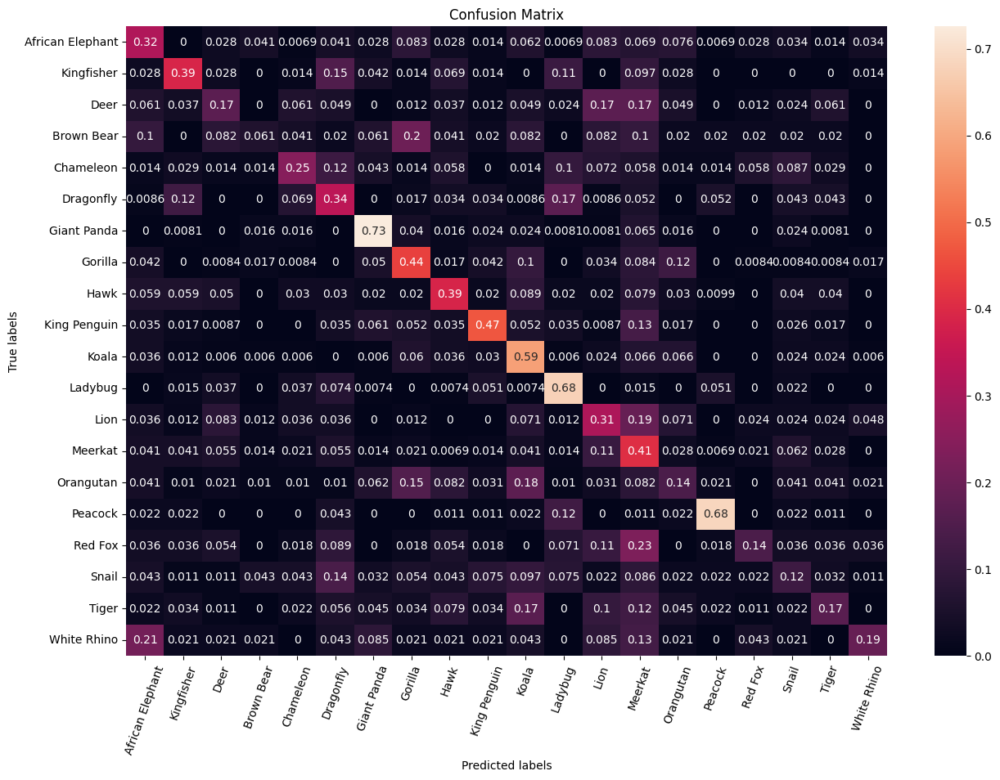

Predicted label ['Brown Bear' 'Snail' 'Ladybug' 'Snail' 'Dragonfly' 'Gorilla'
 'African Elephant' 'Snail' 'Kingfisher']
True label ['African Elephant' 'Koala' 'Kingfisher' 'Chameleon' 'Snail' 'Brown Bear'
 'Chameleon' 'Meerkat' 'Koala']
Corresponding images are shown below


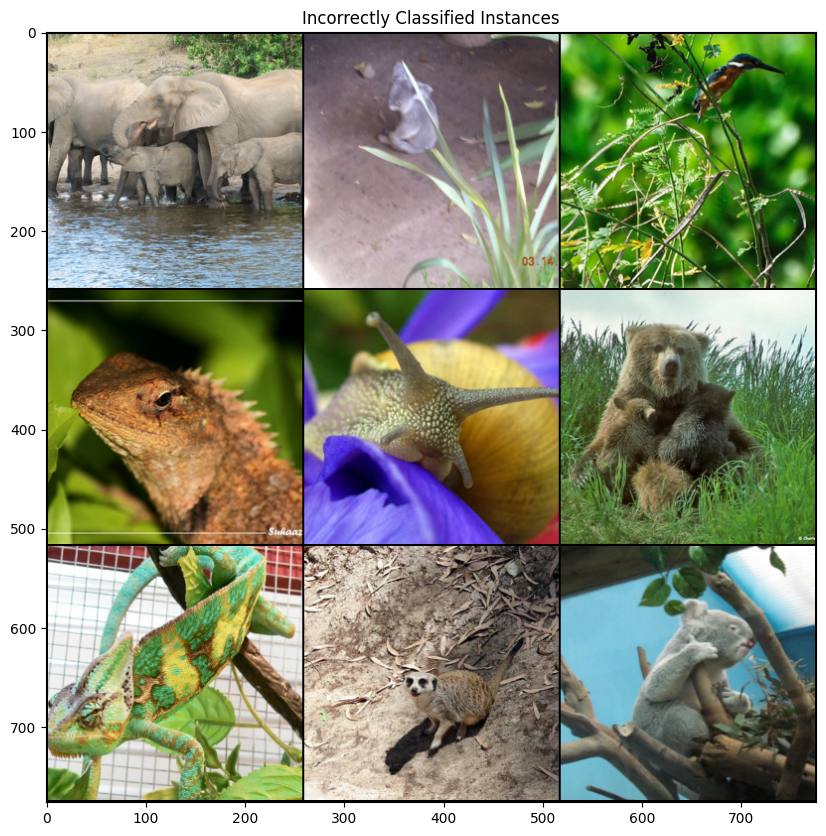

In [ ]:
# define and train the network
model = MyResNet(2)
optimizer = optim.Adamax(model.parameters(), lr=0.0001, weight_decay=1e-7)

params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))

df_losses = train_part(model, optimizer, epochs = 10)

# report test set accuracy
check_accuracy(loader_val, model, analysis=True)


# save the model
torch.save(model.state_dict(), 'model.pt')

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_losses.index+1, y=df_losses['train_loss'],
                    mode='lines',
                    name='Train'))
fig.add_trace(go.Scatter(x=df_losses.index+1, y=df_losses['val_loss'],
                    mode='lines',
                    name='Validation'))

# Edit the layout
fig.update_layout(title='Losses',
                xaxis_title='Epoch',
                yaxis_title='Mean Loss')
fig.update_layout(width=650, height=400 , template="none")
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_losses.index+1, y=df_losses['train_accuracy'],
                    mode='lines',
                    name='Train'))
fig.add_trace(go.Scatter(x=df_losses.index+1, y=df_losses['val_accuracy'],
                    mode='lines',
                    name='Validation'))

# Edit the layout
fig.update_layout(title='Accuracy',
                xaxis_title='Epoch',
                yaxis_title='Accuracy (%)')
fig.update_layout(width=650, height=400 , template="none")
fig.show()

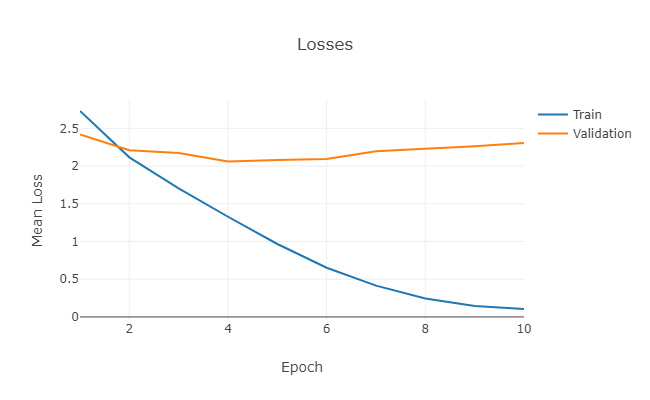

In [96]:
display_image("loss_baseline.png")

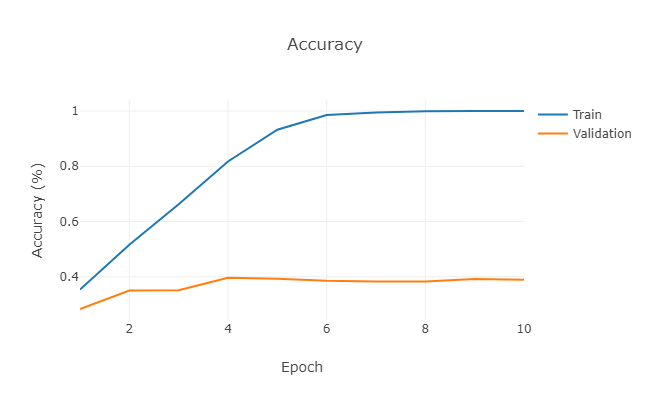

In [97]:
display_image("acc_baseline.png")

Got 717 / 2000 correct of val set (35.85)
check acc <class 'torch.Tensor'> <class 'torch.Tensor'>


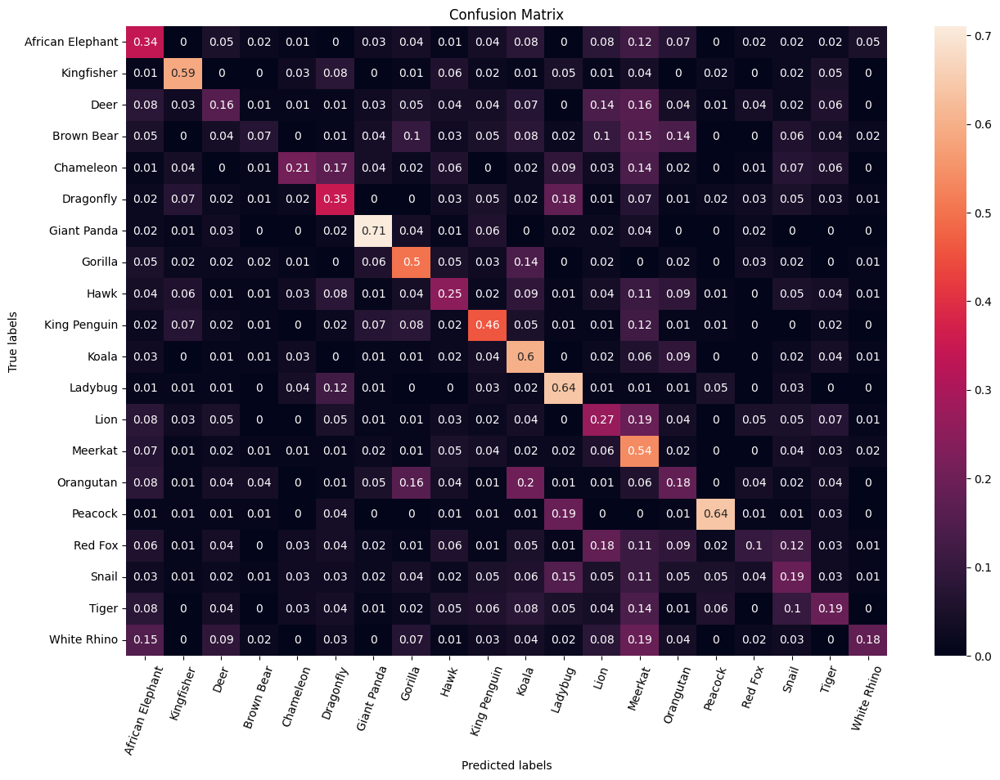

Predicted label ['African Elephant' 'Hawk' 'African Elephant' 'Ladybug' 'Gorilla' 'Koala'
 'African Elephant' 'Dragonfly' 'African Elephant']
True label ['White Rhino' 'Koala' 'Peacock' 'Snail' 'Deer' 'Orangutan' 'Snail'
 'Chameleon' 'Gorilla']
Corresponding images are shown below


0.3585

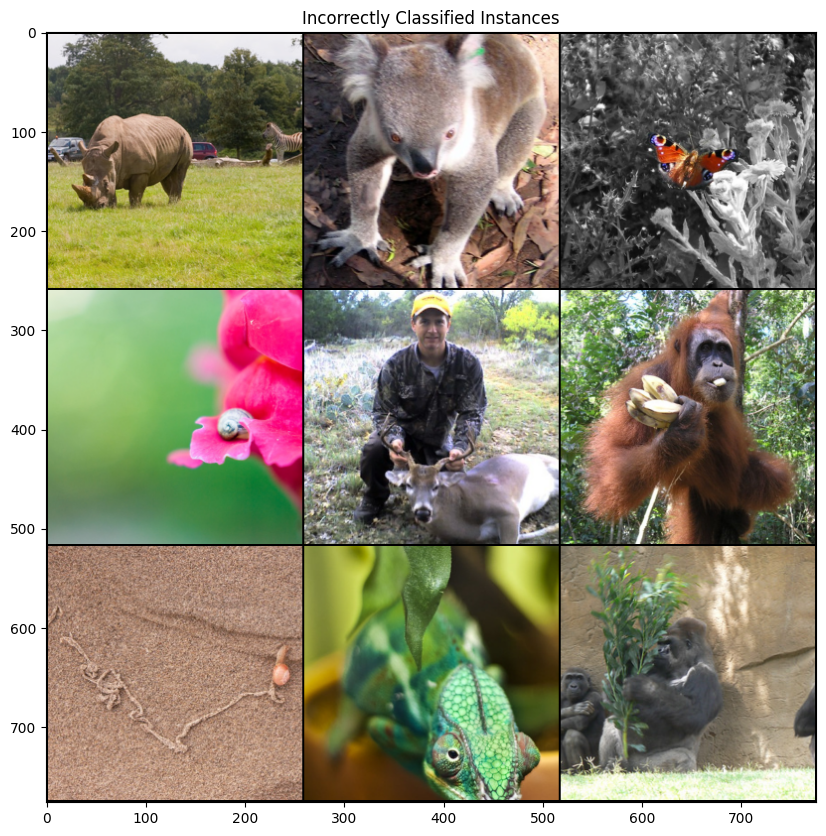

In [ ]:
# Accuracy on test data - Baseline model
check_accuracy(loader_test, model, analysis=True)

In [ ]:
# Save the DataFrame to a CSV file
df_losses.to_csv("df_losses.csv", index=False)

# Hyperparameter tuning using wandb

## wandb setup

In [ ]:
import os
os.environ['WANDB_API_KEY'] = "" # set API key here

In [ ]:
wandb.login()

wandb: Currently logged in as: hfp. Use `wandb login --relogin` to force relogin


True

In [ ]:
method = "bayes"   # other options: grid, random

sweep_config = {
        "name": "resnet_sweep",
        'method': method,
        'metric': {
          'name': 'val_accuracy',
          'goal': 'maximize'
        },
        'parameters': {
            'epochs': {
                'value': 10 # change to 10-30 later
            },
            'batch_size': {
                'values': [32, 64, 96, 128]
            },
            'num_blocks': {
                'values': [2, 3, 4]
            },
            'optimizer': {
                'values': ['adamax', 'adam', 'sgd']
            },
            "lr": {
                'distribution': 'uniform',
                "max": 0.1,
                "min": 0.0001
            },
            "weight_decay": {
                "distribution": "normal",
                "mu": 5e-4,
                "sigma": 1e-5,
            },
    }

In [ ]:
import pprint

pprint.pprint(sweep_config)

{'method': 'bayes',
 'metric': {'goal': 'maximize', 'name': 'val_accuracy'},
 'name': 'resnet_sweep',
 'parameters': {'batch_size': {'values': [32, 64, 96, 128]},
                'epochs': {'value': 1},
                'lr': {'distribution': 'uniform', 'max': 0.1, 'min': 0.0001},
                'num_blocks': {'values': [2, 3, 4]},
                'optimizer': {'values': ['adamax', 'adam', 'sgd']},
                'weight_decay': {'distribution': 'normal',
                                 'mu': 0.0005,
                                 'sigma': 1e-05}}}


In [ ]:
sweep_id = wandb.sweep(sweep_config, project="dl_cw1")

Create sweep with ID: rfjujp6p
Sweep URL: https://wandb.ai/hfp/dl_cw1/sweeps/rfjujp6p


In [ ]:
def build_dataset(batch_size):

    mean = torch.Tensor([0.485, 0.456, 0.406])
    std = torch.Tensor([0.229, 0.224, 0.225])
    transform = transforms.Compose(
            [
                transforms.Resize(256),
                transforms.CenterCrop(256),
                transforms.ToTensor(),
                transforms.Normalize(mean.tolist(), std.tolist()),
            ]
        )
    train_path = ('/content/' if ON_COLAB else '') + 'NaturalImageNetTrain'
    test_path = ('/content/' if ON_COLAB else '') +'NaturalImageNetTest'

    train_dataset = datasets.ImageFolder(train_path, transform=transform)
    test_dataset = datasets.ImageFolder(test_path, transform=transform)

    # Create train val split
    n = len(train_dataset)
    n_val = int(n/10)

    train_set, val_set = torch.utils.data.random_split(train_dataset, [n-n_val, n_val])

    loader_train = DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=2)
    loader_val = DataLoader(val_set, batch_size=batch_size, shuffle=True, num_workers=2)
    loader_test = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=2)

    return loader_train, loader_val, loader_test


def build_network(num_blocks):

    return MyResNet(num_blocks).to(device)


def build_optimizer(network, optimizer, learning_rate, weight_decay):
    if optimizer == "sgd":
        optimizer = optim.SGD(network.parameters(), lr=learning_rate, weight_decay=weight_decay, momentum=0.9)
    elif optimizer == "adam":
        optimizer = optim.Adam(network.parameters(), lr=learning_rate, weight_decay=weight_decay)
    elif optimizer == "adamax":
        optimizer = optim.Adamax(network.parameters(), lr=learning_rate, weight_decay=weight_decay)

    return optimizer


def train_epoch(network, loader_train, optimizer):
    cumu_loss = 0
    for t, (x, y) in enumerate(loader_train):
            network.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = network(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            loss.backward()

            # Update the parameters of the model using the gradients
            optimizer.step()

    return cumu_loss / len(loader_train)

def val_epoch(network, loader_val):
    network.eval()
    with torch.no_grad():
        cumu_loss = 0
        for t, (x, y) in enumerate(loader_val):
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = network(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()
    network.train()
    return cumu_loss / len(loader_val)


In [ ]:

def train(config=None):
    # Initialize a new wandb run
    with wandb.init(config=config):
        # If called by wandb.agent, as below,
        # this config will be set by Sweep Controller
        config = wandb.config

        loader_train, loader_val, loader_test = build_dataset(config.batch_size)
        network = build_network(config.num_blocks)
        optimizer = build_optimizer(network, config.optimizer, config.lr, config.weight_decay)

        for epoch in range(config.epochs):
            train_loss= train_epoch(network, loader_train, optimizer)
            val_loss = val_epoch(network, loader_val)
            wandb.log({"train_loss": train_loss, "epoch": epoch})
            wandb.log({"val_loss": val_loss, "epoch": epoch})
            acc_train = check_accuracy(loader_train, network)
            wandb.log({"train_accuracy": acc_train, "epoch": epoch})
            acc_val = check_accuracy(loader_val, network)
            wandb.log({"val_accuracy": acc_val, "epoch": epoch})

In [ ]:
# Train 15 models, each with a different combination of hyperparameters
wandb.agent(sweep_id, train, count=15)

## Visualizing results of hyperparameter sweep

- The first plot maps hyperparameter values to the validation accuracy (metric we want to maximise). It’s useful for honing in on combinations of hyperparameters that led to the best model performance.
- The hyperparameter importance plot surfaces which hyperparameters were the best predictors of the metric. We report feature importance (from a random forest model) and correlation (implicitly a linear model).

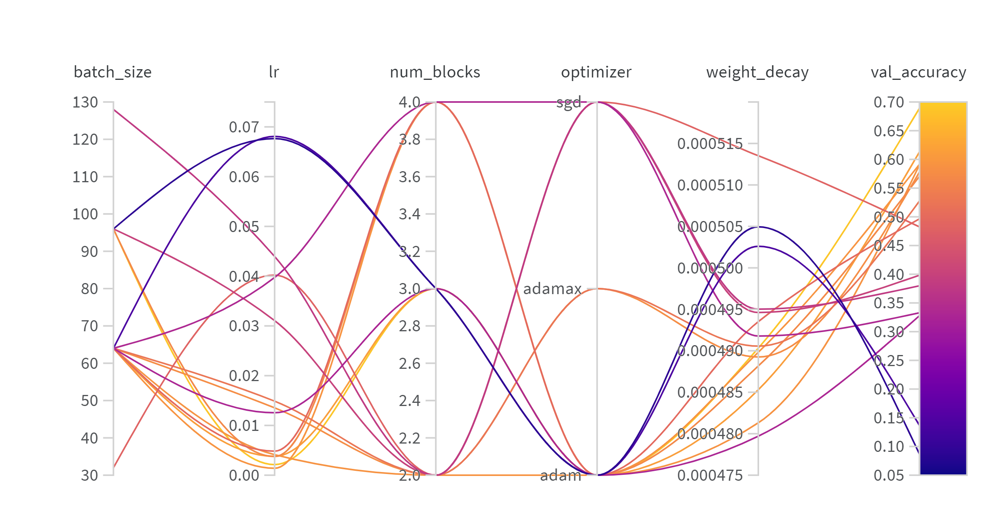

In [39]:
display_image("sweep.png")


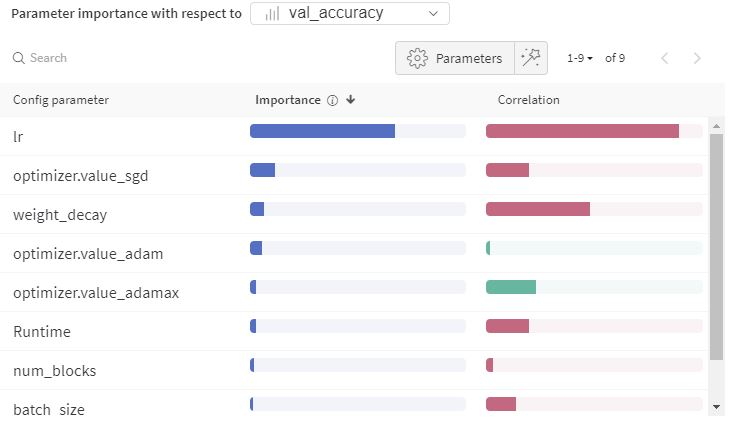

In [41]:
display_image("param_importance.JPG")

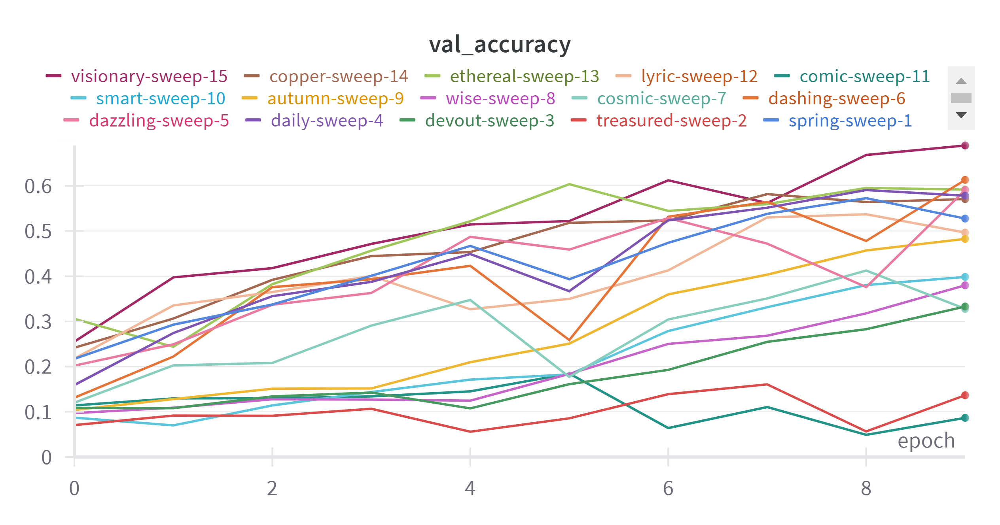

In [42]:
display_image("val_accuracy.png")

# Train model with best hyperparameters

## Best hyperparameters

| Key          | Value                        |
|--------------|------------------------------|
| batch_size   | 96                           |
| epochs       | 10                           |
| lr           | 0.0021272838511651976         |
| num_blocks   | 3                            |
| optimizer    | "adam"                     |
| weight_decay | 0.0004903274580912646         |


In [29]:
best_hyperparameters = {}
best_hyperparameters["batch_size"] = 96
best_hyperparameters["num_blocks"] = 3
best_hyperparameters["lr"] = 0.0021
best_hyperparameters["weight_decay"] = 0.00049

## Train model

17986 1998 2000
Total number of parameters is: 11204164


  0%|          | 0/10 [00:00<?, ?it/s]

Got 5729 / 17986 correct of train set (31.85)
Got 557 / 1998 correct of val set (27.88)
Got 7147 / 17986 correct of train set (39.74)
Got 727 / 1998 correct of val set (36.39)
Got 8914 / 17986 correct of train set (49.56)
Got 938 / 1998 correct of val set (46.95)
Got 9390 / 17986 correct of train set (52.21)
Got 978 / 1998 correct of val set (48.95)
Got 10959 / 17986 correct of train set (60.93)
Got 1095 / 1998 correct of val set (54.80)
Got 10783 / 17986 correct of train set (59.95)
Got 1098 / 1998 correct of val set (54.95)
Got 11732 / 17986 correct of train set (65.23)
Got 1172 / 1998 correct of val set (58.66)
Got 12477 / 17986 correct of train set (69.37)
Got 1200 / 1998 correct of val set (60.06)
Got 13120 / 17986 correct of train set (72.95)
Got 1275 / 1998 correct of val set (63.81)
Got 14307 / 17986 correct of train set (79.55)
Got 1354 / 1998 correct of val set (67.77)
Got 1354 / 1998 correct of val set (67.77)
check acc <class 'torch.Tensor'> <class 'torch.Tensor'>


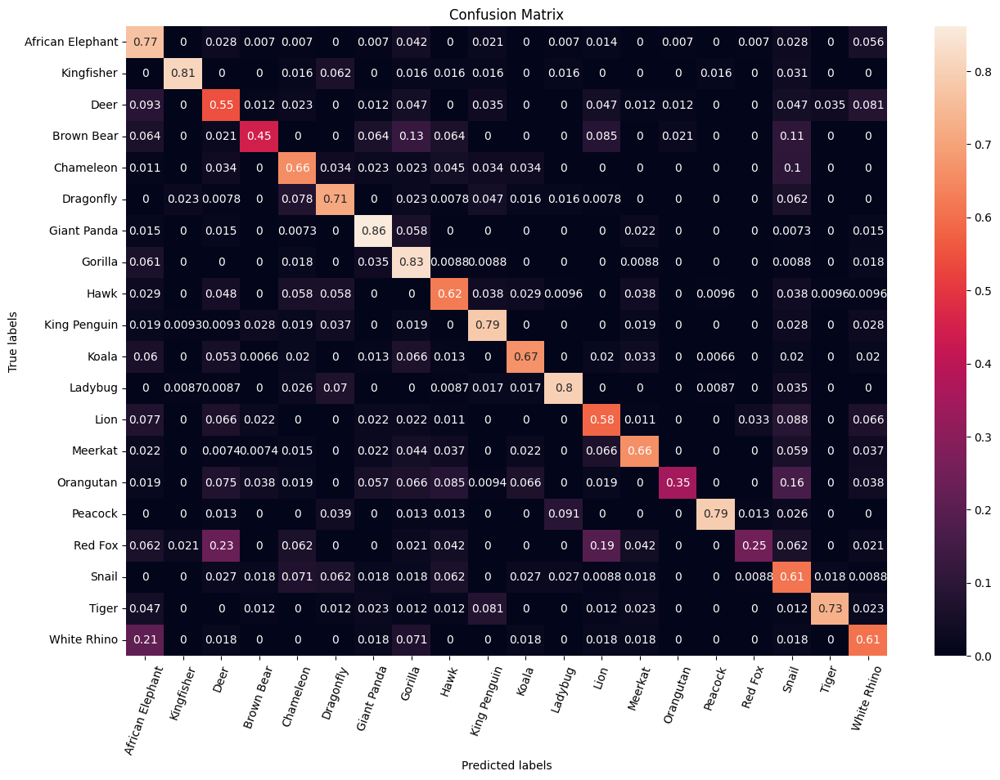

Predicted label ['Tiger' 'Deer' 'King Penguin' 'Deer' 'African Elephant' 'Lion' 'Hawk'
 'Hawk' 'Deer']
True label ['Hawk' 'Meerkat' 'Dragonfly' 'Red Fox' 'Lion' 'Red Fox' 'Snail'
 'Brown Bear' 'Koala']
Corresponding images are shown below


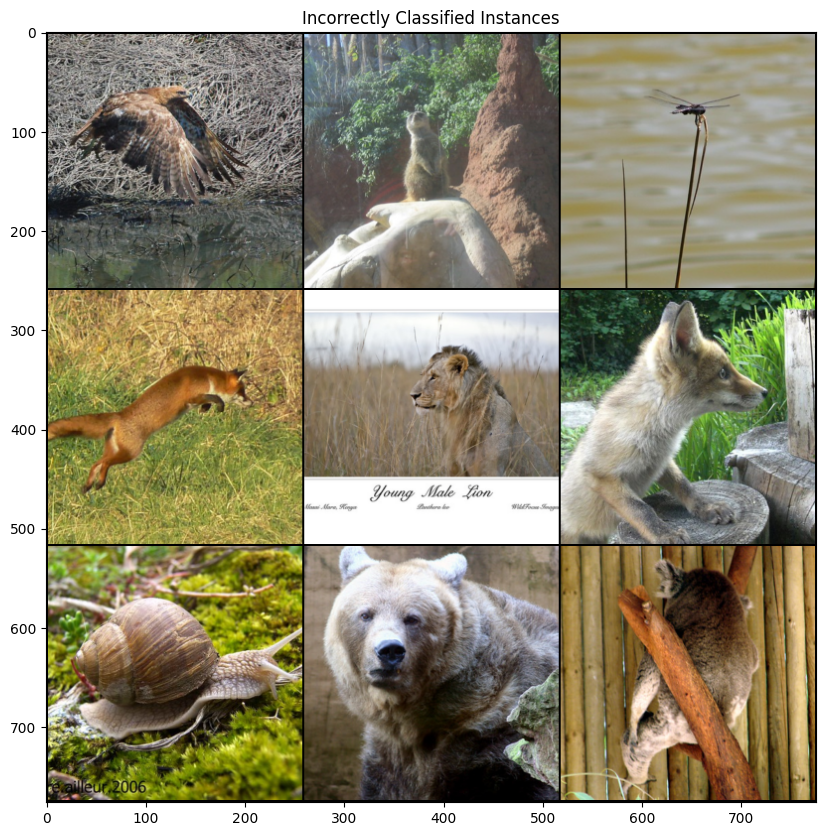

In [59]:
# define and train the network
loader_train, loader_val, loader_test = create_loaders(data_augmentation=False, batch_size=best_hyperparameters["batch_size"])
model = MyResNet(best_hyperparameters["num_blocks"])
optimizer = optim.Adam(model.parameters(), lr=best_hyperparameters["lr"], weight_decay=best_hyperparameters["weight_decay"])

params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))

df_losses_tuned = train_part(model, optimizer, epochs = 10)

# report test set accuracy
check_accuracy(loader_val, model, analysis=True)


# save the model
torch.save(model.state_dict(), 'tuned_model.pt')

In [64]:
# Save the DataFrame to a CSV file
df_losses= pd.read_csv("df_losses.csv")
df_losses

,train_loss,val_loss,train_accuracy,val_accuracy
0,2.729754,2.419380,0.353553,0.283283
1,2.115414,2.210666,0.516068,0.349850
2,1.705418,2.172416,0.662126,0.350851
3,1.328101,2.061843,0.817247,0.396396
4,0.967064,2.079704,0.932003,0.392893
5,0.652496,2.094005,0.985155,0.385385
6,0.414840,2.195518,0.994440,0.382382
7,0.245737,2.224162,0.999500,0.382382
8,0.144459,2.261084,0.999944,0.391892
9,0.105423,2.303995,1.000000,0.388889


In [65]:
plot_loss_comparison(df_losses, df_losses_tuned, text="tuned")

In [66]:
plot_accuracy_comparison(df_losses, df_losses_tuned, text="tuned")

In [67]:
# Save the DataFrame to a CSV file
df_losses_tuned.to_csv("df_losses_tuned.csv", index=False)

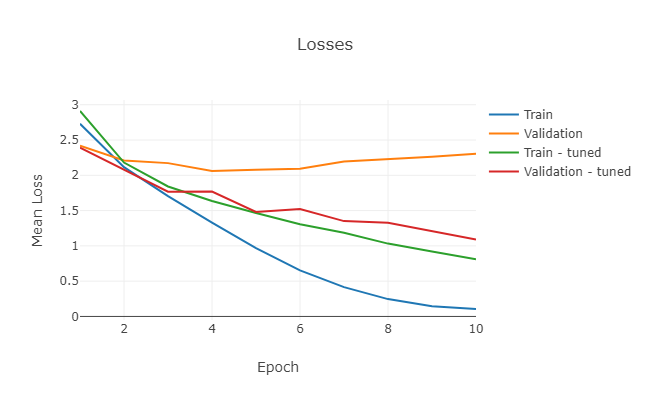

In [98]:
display_image("loss_tuned.png")

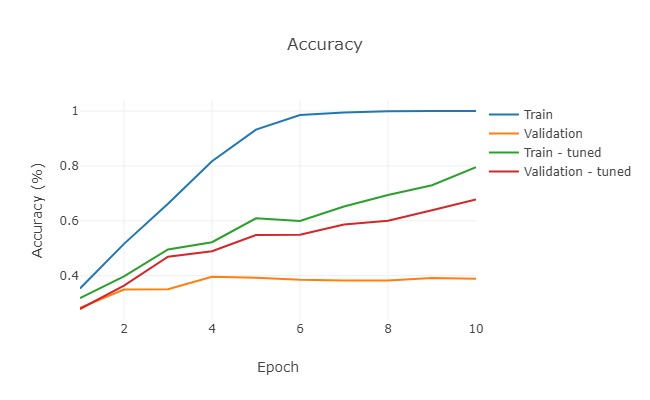

In [99]:
display_image("acc_tuned.png")

## Performance on validation data

In [ ]:
# check accuracy per class

mean = torch.Tensor([0.485, 0.456, 0.406])
std = torch.Tensor([0.229, 0.224, 0.225])

transform = transforms.Compose(
        [
            transforms.Resize(256),
            transforms.CenterCrop(256),
            transforms.ToTensor(),
            transforms.Normalize(mean.tolist(), std.tolist()),
        ]
    )

train_path = ('/content/' if ON_COLAB else '') + 'NaturalImageNetTrain'
train_dataset = datasets.ImageFolder(train_path, transform=transform)
# Get the class names
class_names = train_dataset.classes

# check accuracy per class
# prepare to count predictions for each class
correct_pred = {classname: 0 for classname in class_names}
total_pred = {classname: 0 for classname in class_names}

# again no gradients needed
with torch.no_grad():
    for data in loader_val:
        images, labels = data[0].to(device), data[1].to(device)
        outputs = model(images)
        _, predictions = torch.max(outputs, 1)
        # collect the correct predictions for each class
        for label, prediction in zip(labels, predictions):
            if label == prediction:
                correct_pred[class_names[label]] += 1
            total_pred[class_names[label]] += 1


# print accuracy for each class
for classname, correct_count in correct_pred.items():
    accuracy = 100 * float(correct_count) / total_pred[classname]
    print(f'Accuracy for class: {classname:5s} is {accuracy:.1f} %')

Accuracy for class: African elephant is 71.6 %
Accuracy for class: Eurasiankingfisher is 70.2 %
Accuracy for class: Virginia deer is 55.4 %
Accuracy for class: brown bear is 48.0 %
Accuracy for class: chameleon is 48.7 %
Accuracy for class: dragonfly is 67.5 %
Accuracy for class: giant panda is 83.6 %
Accuracy for class: gorilla is 83.7 %
Accuracy for class: hawk  is 64.7 %
Accuracy for class: king penguin is 77.5 %
Accuracy for class: koala is 79.1 %
Accuracy for class: ladybug is 78.1 %
Accuracy for class: lion  is 61.9 %
Accuracy for class: meerkat is 68.8 %
Accuracy for class: orangutan is 45.4 %
Accuracy for class: peacock is 80.5 %
Accuracy for class: red fox is 21.7 %
Accuracy for class: snail is 40.3 %
Accuracy for class: tiger is 76.1 %
Accuracy for class: white rhinoceros is 25.5 %


# Effect of Data Augmentation

39968 1998 2000
Total number of parameters is: 11204164


  0%|          | 0/10 [00:00<?, ?it/s]

Got 11038 / 39968 correct of train set (27.62)
Got 637 / 1998 correct of val set (31.88)
Got 15405 / 39968 correct of train set (38.54)
Got 889 / 1998 correct of val set (44.49)
Got 18918 / 39968 correct of train set (47.33)
Got 1065 / 1998 correct of val set (53.30)
Got 23392 / 39968 correct of train set (58.53)
Got 1303 / 1998 correct of val set (65.22)
Got 24300 / 39968 correct of train set (60.80)
Got 1400 / 1998 correct of val set (70.07)
Got 24024 / 39968 correct of train set (60.11)
Got 1343 / 1998 correct of val set (67.22)
Got 28344 / 39968 correct of train set (70.92)
Got 1551 / 1998 correct of val set (77.63)
Got 30426 / 39968 correct of train set (76.13)
Got 1625 / 1998 correct of val set (81.33)
Got 30082 / 39968 correct of train set (75.27)
Got 1657 / 1998 correct of val set (82.93)
Got 31562 / 39968 correct of train set (78.97)
Got 1726 / 1998 correct of val set (86.39)
Got 1726 / 1998 correct of val set (86.39)
check acc <class 'torch.Tensor'> <class 'torch.Tensor'>


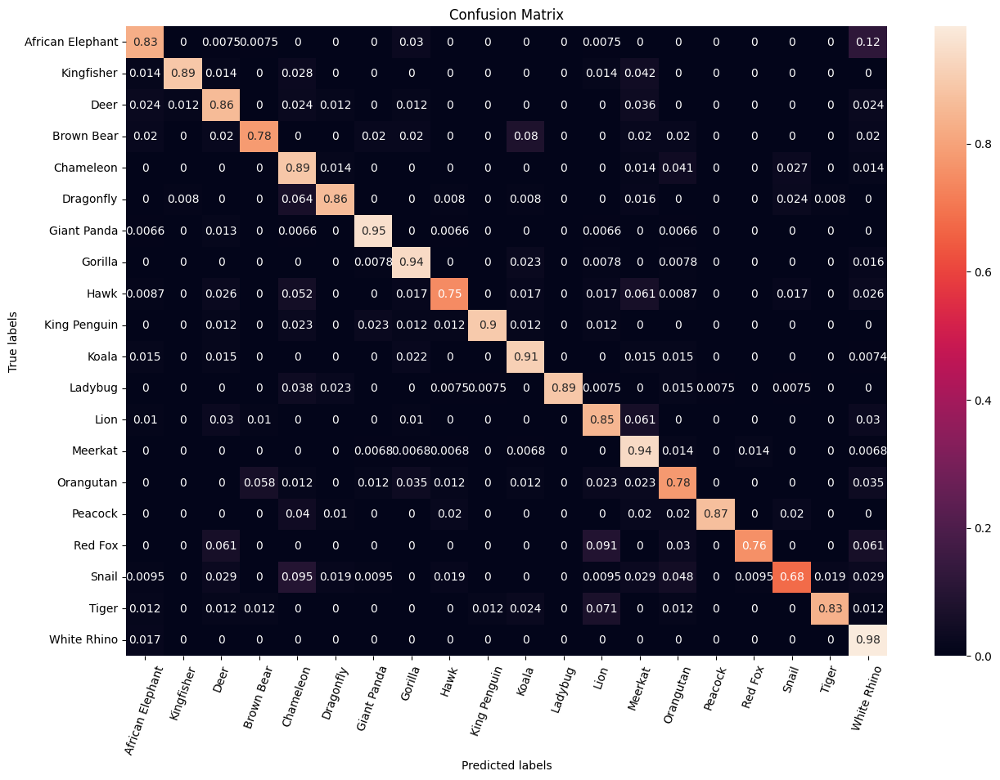

Predicted label ['Gorilla' 'Orangutan' 'Deer' 'Lion' 'White Rhino' 'Meerkat' 'Meerkat'
 'White Rhino' 'Chameleon']
True label ['Meerkat' 'Gorilla' 'Lion' 'Red Fox' 'African Elephant' 'Kingfisher'
 'Lion' 'African Elephant' 'Hawk']
Corresponding images are shown below


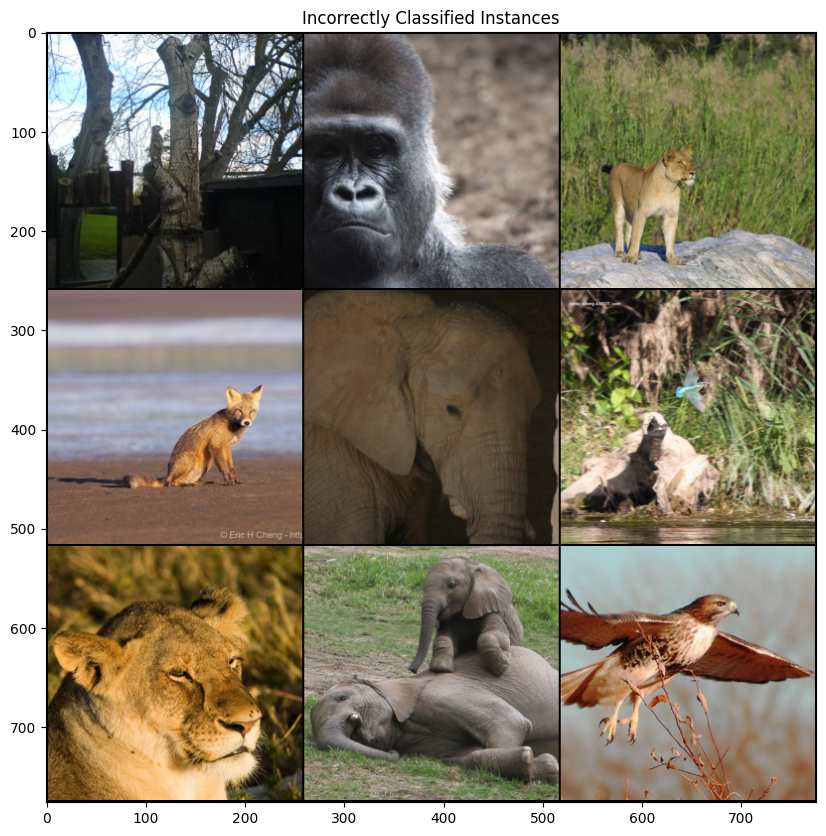

In [49]:
# Train network with data augmentation
loader_train, loader_val, loader_test = create_loaders(data_augmentation=True, batch_size=best_hyperparameters["batch_size"])
model = MyResNet(best_hyperparameters["num_blocks"])
optimizer = optim.Adam(model.parameters(), lr=best_hyperparameters["lr"], weight_decay=best_hyperparameters["weight_decay"])

params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))

df_losses_augmented = train_part(model, optimizer, epochs=10)

# report test set accuracy
check_accuracy(loader_val, model, analysis=True)

# save the model
torch.save(model.state_dict(), 'model_data_augmentation.pt')

In [69]:
plot_loss_comparison(df_losses_tuned, df_losses_augmented)

In [70]:
plot_accuracy_comparison(df_losses_tuned, df_losses_augmented)

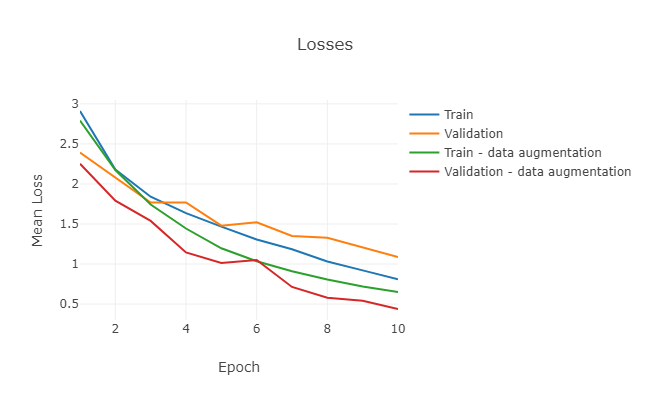

In [100]:
display_image("loss_augmented.png")

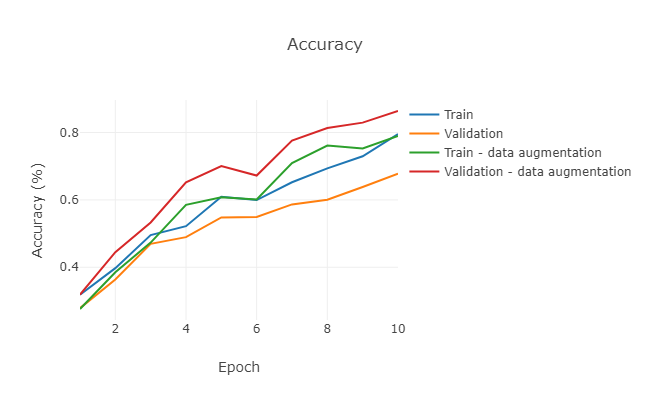

In [101]:
display_image("acc_augmented.png")

# Effect of learning rate scheduler

In [75]:
def train_part_with_scheduler(model, optimizer, scheduler, epochs=1):
    """
    Train a model on NaturalImageNet using the PyTorch Module API.

    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for

    Returns: Nothing, but prints model accuracies during training.
    """
    train_losses = []
    val_losses = []
    val_accuracy = []
    train_accuracy = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    for e in tqdm(range(epochs)):
        model.train()
        cumu_loss = 0
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()
            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            loss.backward()

            # Update the parameters of the model using the gradients
            optimizer.step()

            # if t % print_every == 0:
            #     print('Epoch: %d, Iteration %d, loss = %.4f' % (e, t, loss.item()))

        train_losses.append(cumu_loss / len(loader_train))
        train_accuracy.append(check_accuracy(loader_train, model, loader_type="train"))
        val_accuracy.append(check_accuracy(loader_val, model))
        scheduler.step()

        model.eval()
        with torch.no_grad():
            cumu_loss = 0
            for t, (x, y) in enumerate(loader_val):
                x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
                y = y.to(device=device, dtype=torch.long)

                scores = model(x)
                loss = F.cross_entropy(scores, y)
                cumu_loss += loss.item()

            val_losses.append(cumu_loss / len(loader_val))


        df_losses = pd.DataFrame(list(zip(train_losses, val_losses, train_accuracy, val_accuracy)),
            columns =['train_loss', 'val_loss', 'train_accuracy', 'val_accuracy'])

    return df_losses

17986 1998 2000
Total number of parameters is: 11204164


  0%|          | 0/10 [00:00<?, ?it/s]

Got 5389 / 17986 correct of train set (29.96)
Got 594 / 1998 correct of val set (29.73)
Got 8539 / 17986 correct of train set (47.48)
Got 909 / 1998 correct of val set (45.50)
Got 10035 / 17986 correct of train set (55.79)
Got 1031 / 1998 correct of val set (51.60)
Got 11842 / 17986 correct of train set (65.84)
Got 1147 / 1998 correct of val set (57.41)
Got 13185 / 17986 correct of train set (73.31)
Got 1226 / 1998 correct of val set (61.36)
Got 14396 / 17986 correct of train set (80.04)
Got 1267 / 1998 correct of val set (63.41)
Got 14989 / 17986 correct of train set (83.34)
Got 1290 / 1998 correct of val set (64.56)
Got 15436 / 17986 correct of train set (85.82)
Got 1302 / 1998 correct of val set (65.17)
Got 15678 / 17986 correct of train set (87.17)
Got 1304 / 1998 correct of val set (65.27)
Got 15815 / 17986 correct of train set (87.93)
Got 1309 / 1998 correct of val set (65.52)
Got 1309 / 1998 correct of val set (65.52)
check acc <class 'torch.Tensor'> <class 'torch.Tensor'>


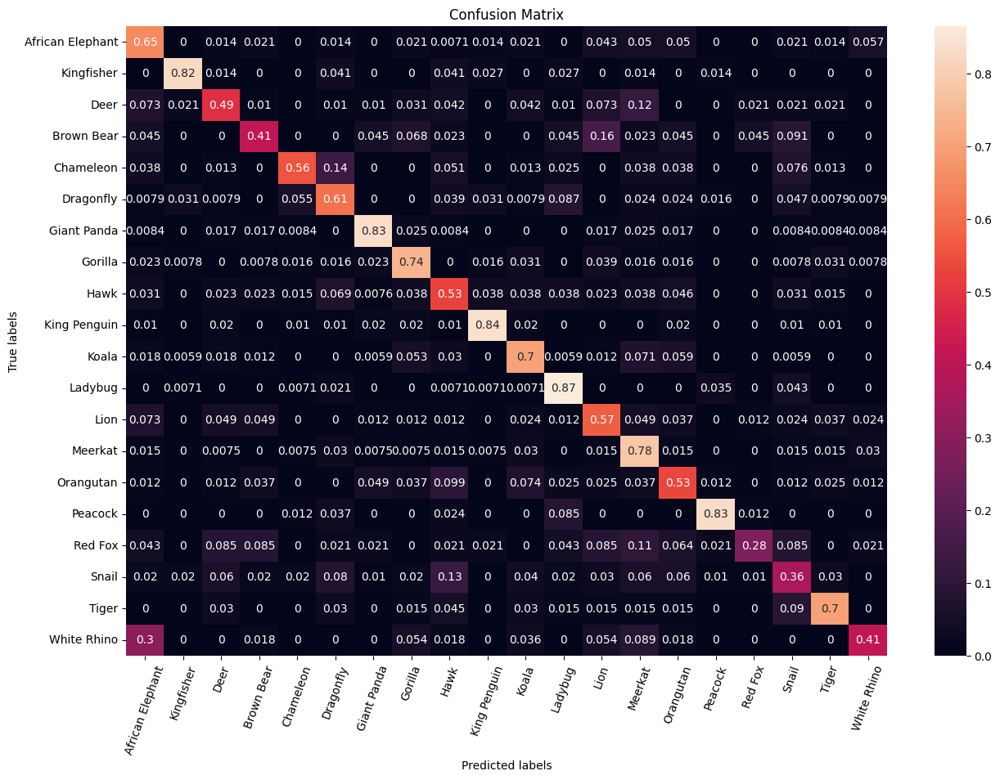

Predicted label ['Orangutan' 'Lion' 'Ladybug' 'Brown Bear' 'Peacock' 'Hawk' 'Snail'
 'Koala' 'African Elephant']
True label ['Brown Bear' 'Hawk' 'Red Fox' 'Gorilla' 'Ladybug' 'Snail' 'Brown Bear'
 'Gorilla' 'White Rhino']
Corresponding images are shown below


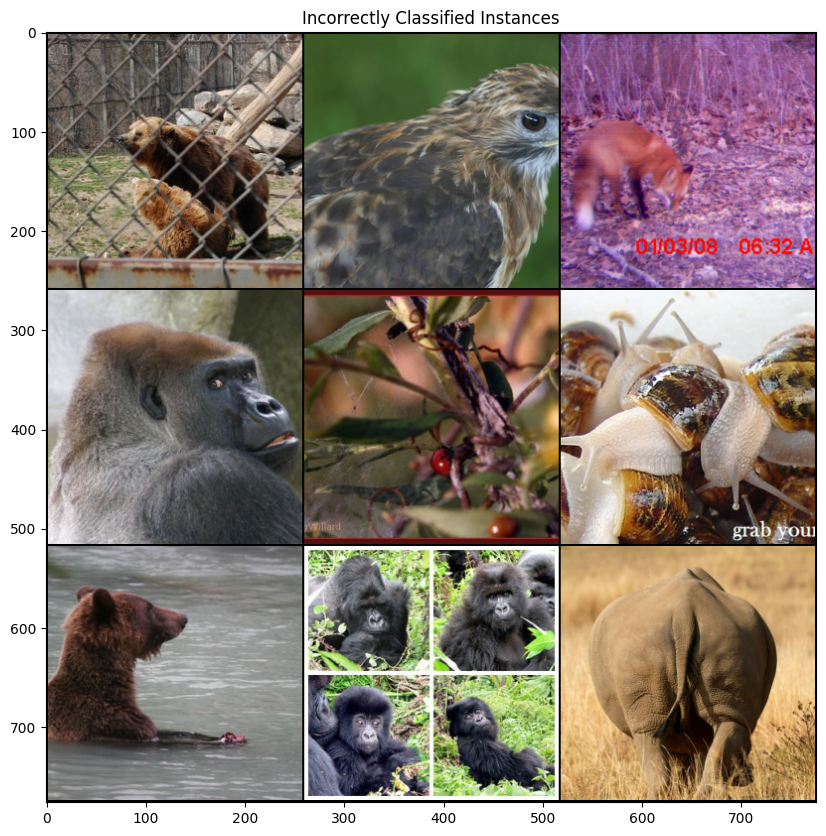

In [76]:
# Train network with learning rate scheduler
loader_train, loader_val, loader_test = create_loaders(data_augmentation=False, batch_size=best_hyperparameters["batch_size"])
model = MyResNet(best_hyperparameters["num_blocks"])
optimizer = optim.Adam(model.parameters(), lr=best_hyperparameters["lr"], weight_decay=best_hyperparameters["weight_decay"])
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.5, last_epoch=-1, verbose=False)

params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))

df_losses_scheduler = train_part_with_scheduler(model, optimizer, scheduler, epochs=10)

# report test set accuracy
check_accuracy(loader_val, model, analysis=True)

# save the model
torch.save(model.state_dict(), 'model_scheduler.pt')

In [77]:
plot_loss_comparison(df_losses_tuned, df_losses_scheduler, text="with scheduler")

In [78]:
plot_accuracy_comparison(df_losses_tuned, df_losses_scheduler, text="with scheduler")

In [79]:
# Save the DataFrame to a CSV file
df_losses_scheduler.to_csv("df_losses_scheduler.csv", index=False)

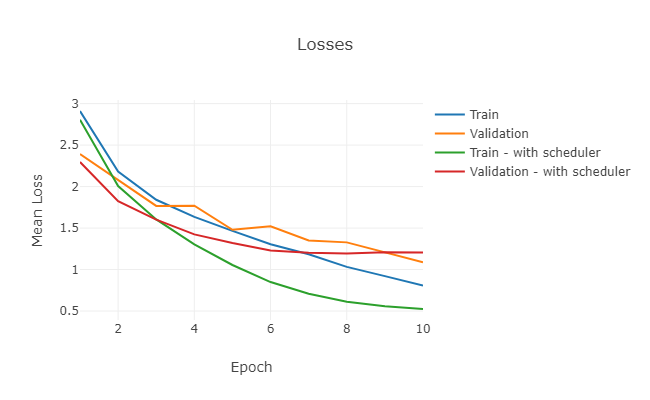

In [102]:
display_image("loss_lr.png")

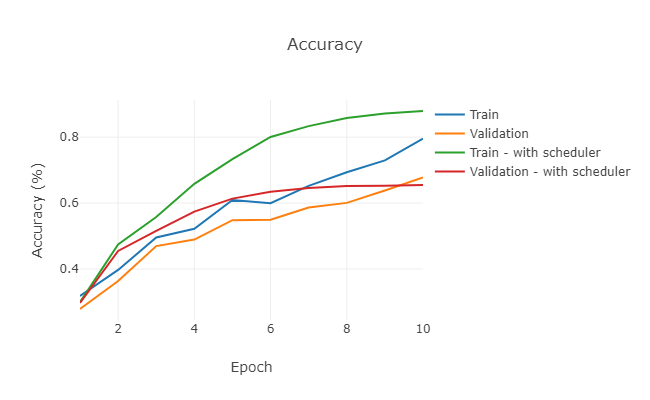

In [103]:
display_image("acc_lr.png")

# Effect of longer training & Early stopping

In [30]:
from torch.optim.lr_scheduler import StepLR

def train_part_early_stopping(model, optimizer, epochs=1, patience=5):
    """
    Train a model on NaturalImageNet using the PyTorch Module API with early stopping.

    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model.
    - scheduler: A learning rate scheduler.
    - epochs: (Optional) A Python integer giving the number of epochs to train for.
    - patience: (Optional) Number of epochs with no improvement after which training will be stopped.

    Returns: A DataFrame containing training and validation losses and accuracies.
    """
    train_losses = []
    val_losses = []
    val_accuracy = []
    train_accuracy = []
    best_val_loss = float('inf')
    no_improvement_count = 0
    model = model.to(device=device)  # move the model parameters to CPU/GPU

    for e in tqdm(range(epochs)):
        model.train()
        cumu_loss = 0
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        train_losses.append(cumu_loss / len(loader_train))
        train_accuracy.append(check_accuracy(loader_train, model, loader_type="train"))
        val_accuracy.append(check_accuracy(loader_val, model))

        model.eval()
        cumu_loss = 0
        for t, (x, y) in enumerate(loader_val):
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()

        val_loss = cumu_loss / len(loader_val)
        val_losses.append(val_loss)

        # Step the learning rate scheduler at the end of each epoch
        scheduler.step()

        # Early stopping check
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            no_improvement_count = 0
        else:
            no_improvement_count += 1

        if no_improvement_count >= patience:
            print(f"Stopping early. No improvement for {patience} consecutive epochs.")
            break

    df_losses = pd.DataFrame(list(zip(train_losses, val_losses, train_accuracy, val_accuracy)),
                             columns=['train_loss', 'val_loss', 'train_accuracy', 'val_accuracy'])

    return df_losses


17986 1998 2000
Total number of parameters is: 11204164


  0%|          | 0/30 [00:00<?, ?it/s]

Got 5721 / 17986 correct of train set (31.81)
Got 582 / 1998 correct of val set (29.13)
Got 9353 / 17986 correct of train set (52.00)
Got 951 / 1998 correct of val set (47.60)
Got 10700 / 17986 correct of train set (59.49)
Got 1076 / 1998 correct of val set (53.85)
Got 12263 / 17986 correct of train set (68.18)
Got 1166 / 1998 correct of val set (58.36)
Got 13679 / 17986 correct of train set (76.05)
Got 1263 / 1998 correct of val set (63.21)
Got 14670 / 17986 correct of train set (81.56)
Got 1288 / 1998 correct of val set (64.46)
Got 15515 / 17986 correct of train set (86.26)
Got 1305 / 1998 correct of val set (65.32)
Got 15832 / 17986 correct of train set (88.02)
Got 1319 / 1998 correct of val set (66.02)
Got 16069 / 17986 correct of train set (89.34)
Got 1331 / 1998 correct of val set (66.62)
Got 16146 / 17986 correct of train set (89.77)
Got 1328 / 1998 correct of val set (66.47)
Got 16183 / 17986 correct of train set (89.98)
Got 1329 / 1998 correct of val set (66.52)
Got 16228 / 17

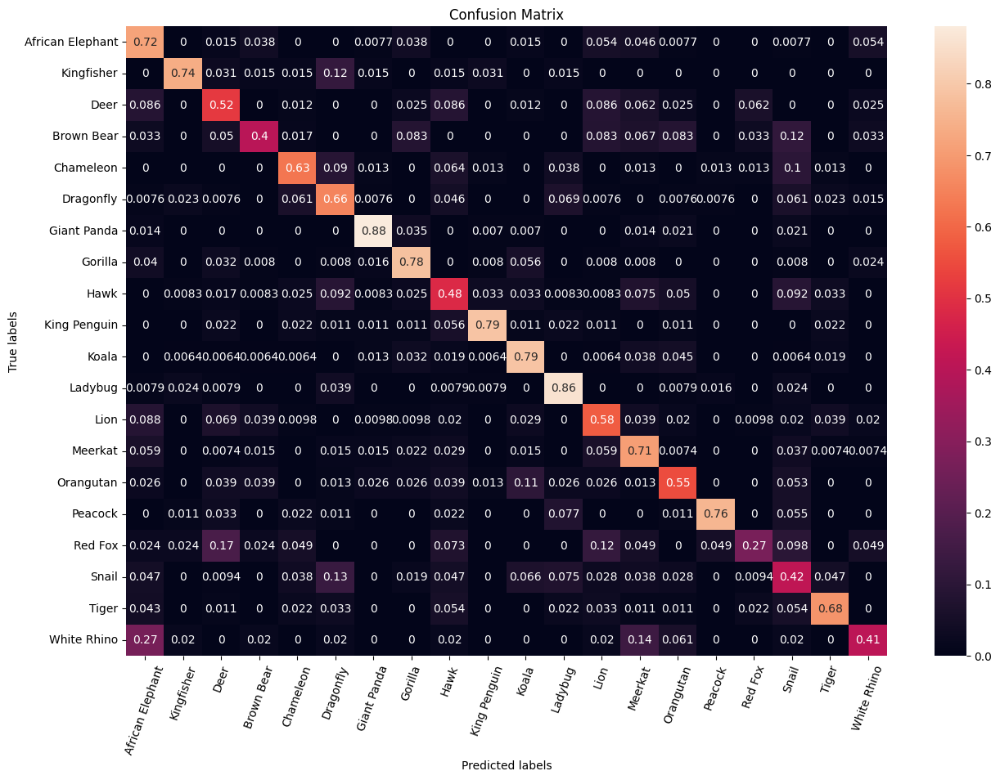

Predicted label ['White Rhino' 'Koala' 'Meerkat' 'Tiger' 'Tiger' 'African Elephant'
 'Tiger' 'Lion' 'African Elephant']
True label ['Brown Bear' 'Snail' 'Snail' 'Dragonfly' 'Chameleon' 'Deer' 'Snail'
 'Orangutan' 'White Rhino']
Corresponding images are shown below


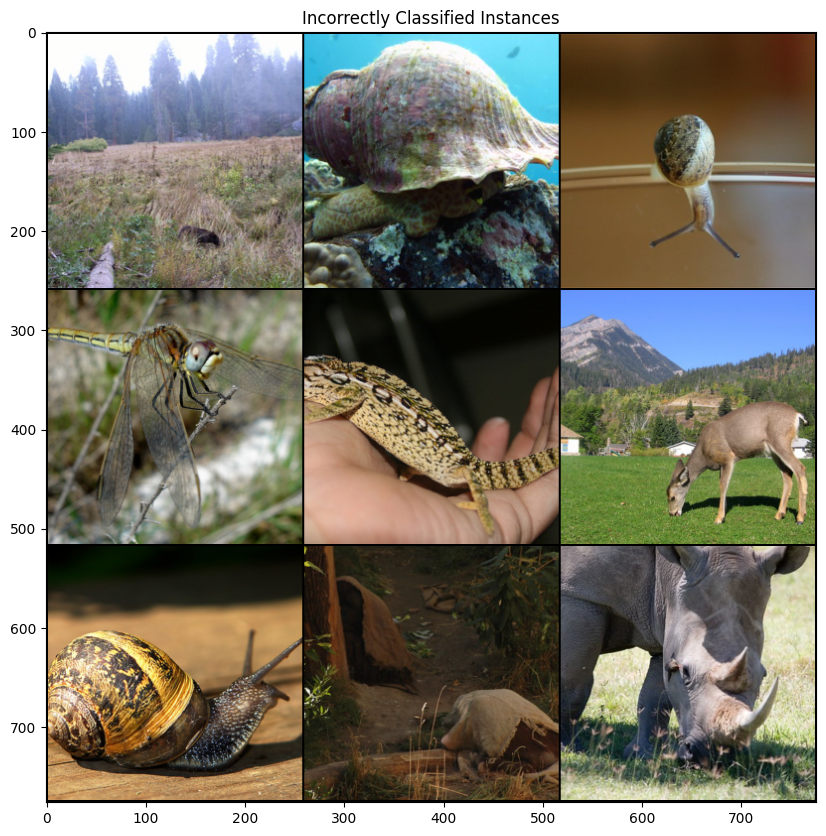

In [31]:

loader_train, loader_val, loader_test = create_loaders(data_augmentation=False, batch_size=best_hyperparameters["batch_size"])
model = MyResNet(best_hyperparameters["num_blocks"])
optimizer = optim.Adam(model.parameters(), lr=best_hyperparameters["lr"], weight_decay=best_hyperparameters["weight_decay"])

params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))

df_losses_early_stopping = train_part_early_stopping(model, optimizer, epochs=30, patience=3)

# report test set accuracy
check_accuracy(loader_val, model, analysis=True)

# save the model
torch.save(model.state_dict(), 'model_early_stopping.pt')

In [72]:
# Save the DataFrame to a CSV file
df_losses_tuned= pd.read_csv("df_losses_tuned.csv")
df_losses_tuned

,train_loss,val_loss,train_accuracy,val_accuracy
0,2.910954,2.391645,0.318526,0.278779
1,2.180060,2.084131,0.397365,0.363864
2,1.841101,1.767324,0.495608,0.469469
3,1.635404,1.769474,0.522073,0.489489
4,1.466464,1.479431,0.609307,0.548048
5,1.306009,1.521861,0.599522,0.549550
6,1.185079,1.350563,0.652285,0.586587
7,1.032056,1.327698,0.693706,0.600601
8,0.921137,1.206788,0.729456,0.638138
9,0.808719,1.088770,0.795452,0.677678


In [73]:
plot_loss_comparison(df_losses_tuned, df_losses_early_stopping, text="with early stopping")

In [74]:
plot_accuracy_comparison(df_losses_tuned, df_losses_early_stopping, text="with early stopping")

In [37]:
# Save the DataFrame to a CSV file
df_losses_early_stopping.to_csv("df_losses_early_stopping.csv", index=False)

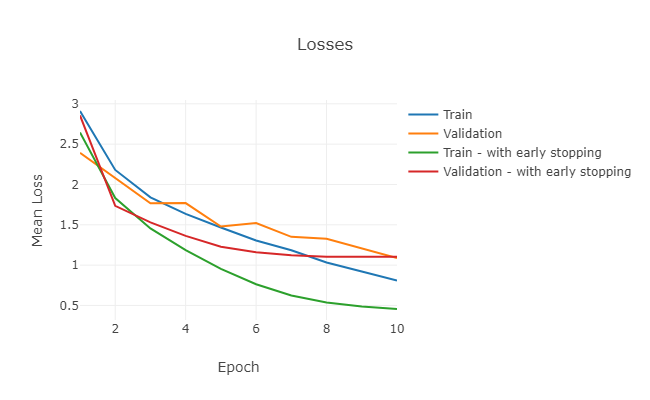

In [104]:
display_image("loss_es.png")

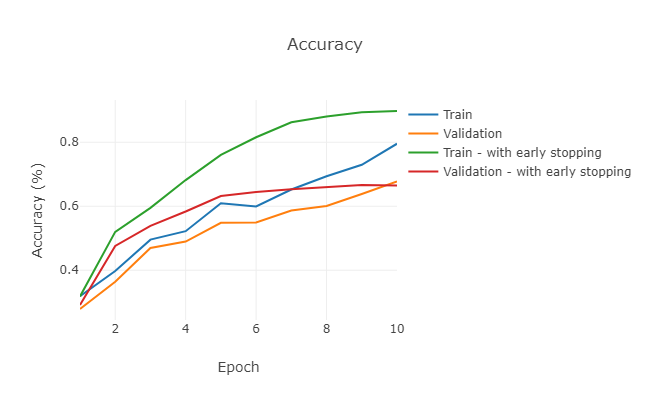

In [105]:
display_image("acc_es.png")

# Train final model

In [80]:
def train_part_final(model, optimizer, scheduler, epochs=1, patience=5):
    """
    Train a model on NaturalImageNet using the PyTorch Module API with early stopping.

    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model.
    - scheduler: A learning rate scheduler.
    - epochs: (Optional) A Python integer giving the number of epochs to train for.
    - patience: (Optional) Number of epochs with no improvement after which training will be stopped.

    Returns: A DataFrame containing training and validation losses and accuracies.
    """
    train_losses = []
    val_losses = []
    val_accuracy = []
    train_accuracy = []
    best_val_loss = float('inf')
    no_improvement_count = 0
    model = model.to(device=device)  # move the model parameters to CPU/GPU

    for e in tqdm(range(epochs)):
        model.train()
        cumu_loss = 0
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        train_losses.append(cumu_loss / len(loader_train))
        train_accuracy.append(check_accuracy(loader_train, model, loader_type="train"))
        val_accuracy.append(check_accuracy(loader_val, model))
        scheduler.step()

        model.eval()
        cumu_loss = 0
        for t, (x, y) in enumerate(loader_val):
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = F.cross_entropy(scores, y)
            cumu_loss += loss.item()

        val_loss = cumu_loss / len(loader_val)
        val_losses.append(val_loss)

        # Step the learning rate scheduler at the end of each epoch
        scheduler.step()

        # Early stopping check
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            no_improvement_count = 0
        else:
            no_improvement_count += 1

        if no_improvement_count >= patience:
            print(f"Stopping early. No improvement for {patience} consecutive epochs.")
            break

    df_losses = pd.DataFrame(list(zip(train_losses, val_losses, train_accuracy, val_accuracy)),
                             columns=['train_loss', 'val_loss', 'train_accuracy', 'val_accuracy'])

    return df_losses

39968 1998 2000
Total number of parameters is: 11204164


  0%|          | 0/30 [00:00<?, ?it/s]

Got 12944 / 39968 correct of train set (32.39)
Got 753 / 1998 correct of val set (37.69)
Got 18846 / 39968 correct of train set (47.15)
Got 1082 / 1998 correct of val set (54.15)
Got 24589 / 39968 correct of train set (61.52)
Got 1369 / 1998 correct of val set (68.52)
Got 26375 / 39968 correct of train set (65.99)
Got 1488 / 1998 correct of val set (74.47)
Got 27304 / 39968 correct of train set (68.31)
Got 1537 / 1998 correct of val set (76.93)
Got 27516 / 39968 correct of train set (68.85)
Got 1546 / 1998 correct of val set (77.38)
Got 27601 / 39968 correct of train set (69.06)
Got 1548 / 1998 correct of val set (77.48)
Got 27671 / 39968 correct of train set (69.23)
Got 1555 / 1998 correct of val set (77.83)
Got 27549 / 39968 correct of train set (68.93)
Got 1542 / 1998 correct of val set (77.18)
Got 27516 / 39968 correct of train set (68.85)
Got 1553 / 1998 correct of val set (77.73)
Got 27555 / 39968 correct of train set (68.94)
Got 1547 / 1998 correct of val set (77.43)
Stopping ea

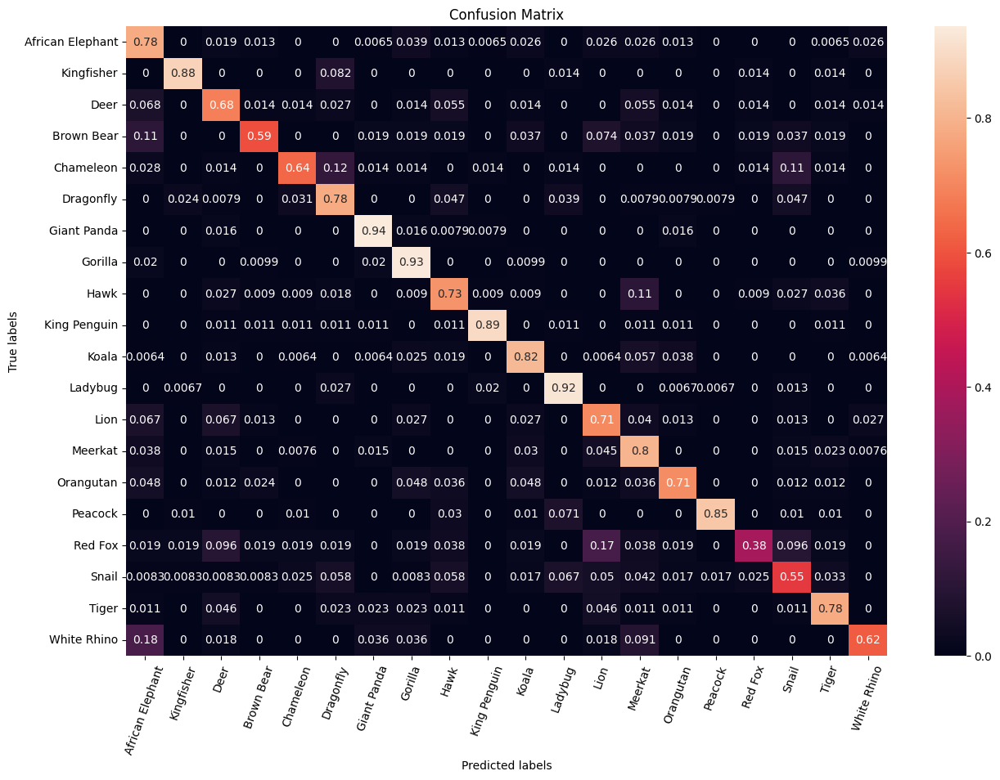

Predicted label ['Snail' 'Ladybug' 'Snail' 'Brown Bear' 'Koala' 'African Elephant' 'Deer'
 'African Elephant' 'Lion']
True label ['Meerkat' 'Snail' 'Hawk' 'Lion' 'Gorilla' 'Deer' 'Red Fox' 'Deer'
 'Meerkat']
Corresponding images are shown below


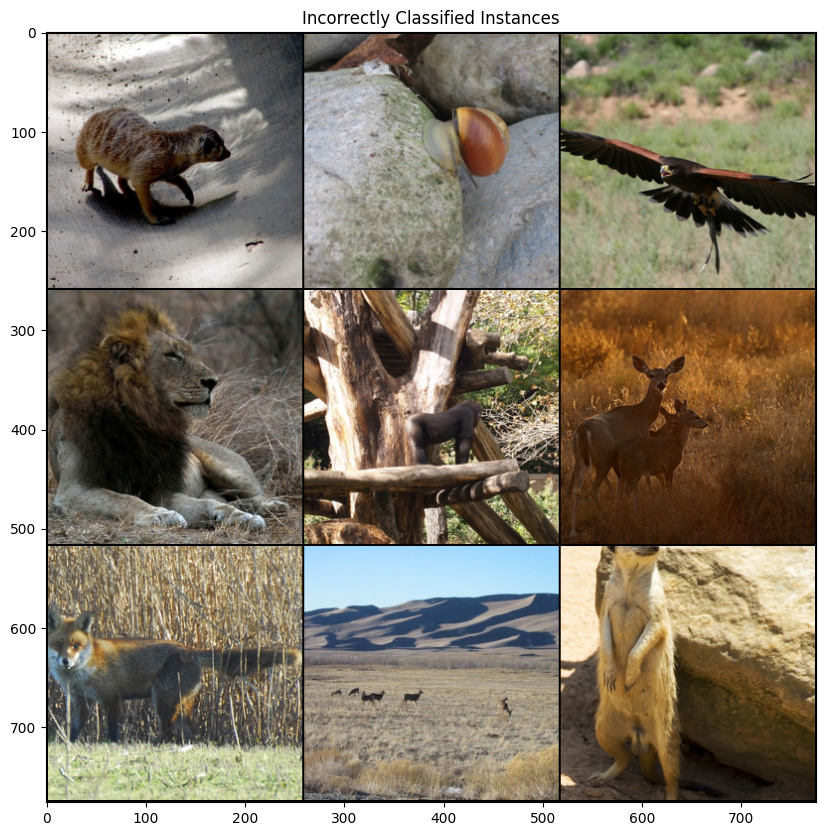

In [82]:
# Train network with learning rate scheduler
loader_train, loader_val, loader_test = create_loaders(data_augmentation=True, batch_size=best_hyperparameters["batch_size"])
model = MyResNet(best_hyperparameters["num_blocks"])
optimizer = optim.Adam(model.parameters(), lr=best_hyperparameters["lr"], weight_decay=best_hyperparameters["weight_decay"])
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.5, last_epoch=-1, verbose=False)

params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))

df_losses_final = train_part_final(model, optimizer, scheduler, epochs=30, patience=3)

# report test set accuracy
check_accuracy(loader_val, model, analysis=True)

# save the model
torch.save(model.state_dict(), 'model_final.pt')

In [86]:
# Save the DataFrame to a CSV file
df_losses_final.to_csv("df_losses_final.csv", index=False)

In [ ]:
# Read the CSV file into a Pandas DataFrame
df_losses = pd.read_csv("df_losses.csv")

In [87]:
plot_loss_comparison(df_losses, df_losses_final, text="final")

In [89]:
plot_accuracy_comparison(df_losses, df_losses_final, text="final")

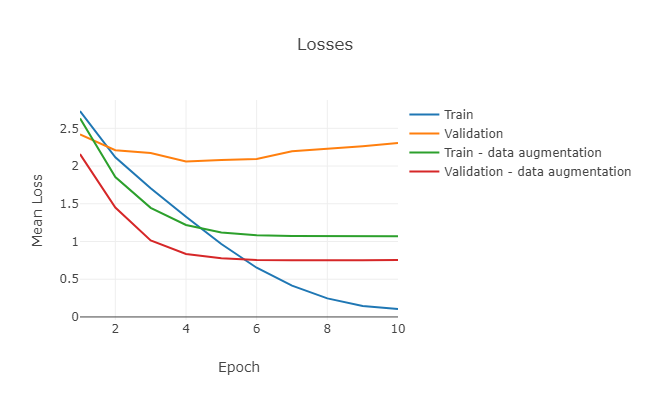

In [106]:
display_image("loss_final.png")

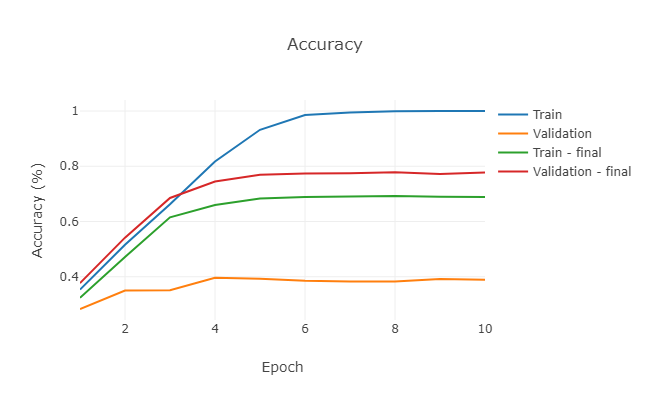

In [107]:
display_image("acc_final.png")

# Feature visualization

In [92]:
mean = torch.Tensor([0.485, 0.456, 0.406])
std = torch.Tensor([0.229, 0.224, 0.225])

transform = transforms.Compose(
        [
            transforms.Resize(256),
            transforms.CenterCrop(256),
            transforms.ToTensor(),
            transforms.Normalize(mean.tolist(), std.tolist()),
        ]
    )
test_path = ('/content/' if ON_COLAB else '') +'NaturalImageNetTest'
test_dataset = datasets.ImageFolder(test_path, transform=transform)

In [93]:
import matplotlib.pyplot as plt

def plot_model_features():
    fig = plt.tight_layout()
    activation = {}
    def get_activation(name):
        def hook(model, input, output):
            activation[name] = output.detach()
        return hook
    vis_labels = ['conv1', 'layer1', 'layer2', 'layer3', 'layer4', 'layer5', 'layer6']

    for l in vis_labels:
        getattr(model, l).register_forward_hook(get_activation(l))


    data, _ = test_dataset[999]
    data = data.unsqueeze_(0).to(device = device, dtype = dtype)
    output = model(data)

    for idx, l in enumerate(vis_labels):
        act = activation[l].squeeze()

        # only showing the first 16 channels
        ncols, nrows = 8, 2

        fig, axarr = plt.subplots(nrows, ncols, figsize=(15,5))
        fig.suptitle(l)

        count = 0
        for i in range(nrows):
            for j in range(ncols):
                axarr[i, j].imshow(act[count].cpu())
                axarr[i, j].axis('off')
                count += 1

<Figure size 640x480 with 0 Axes>

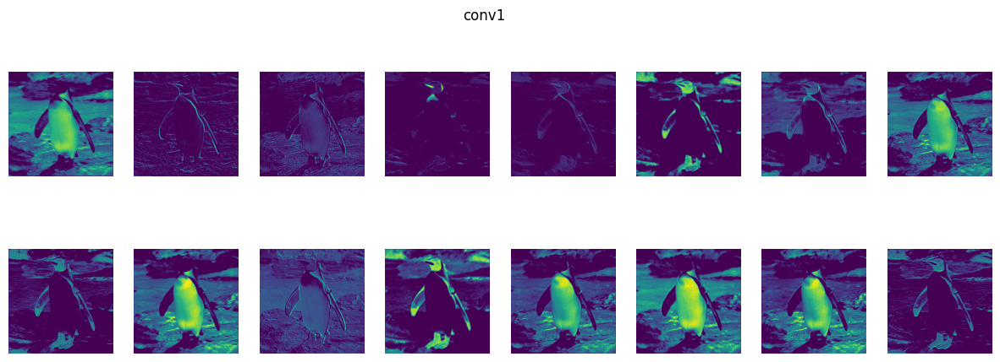

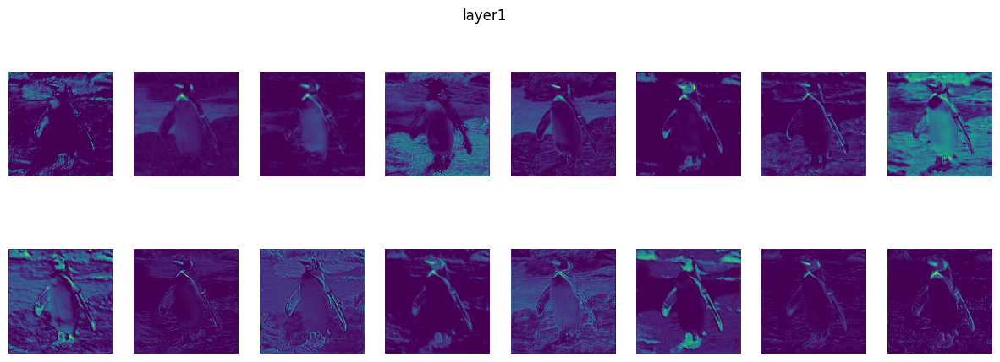

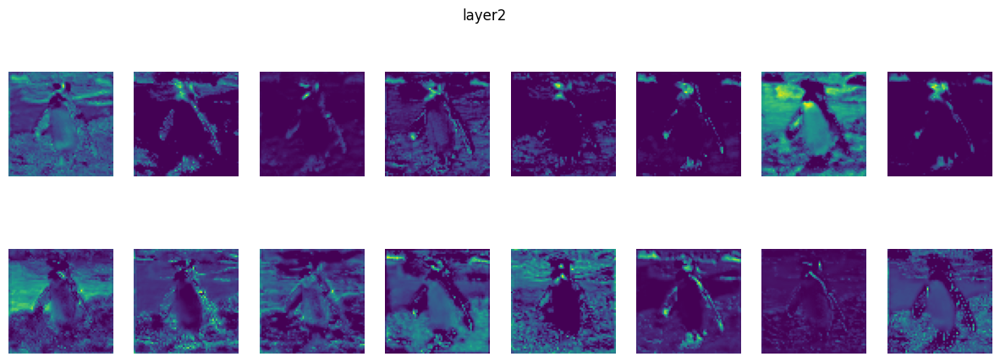

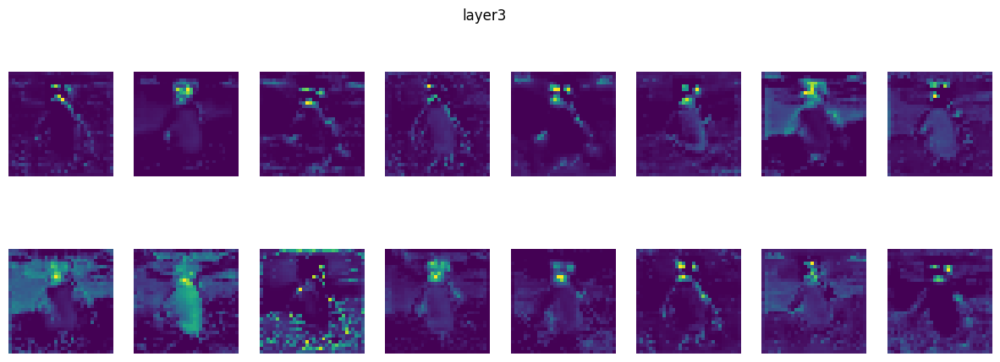

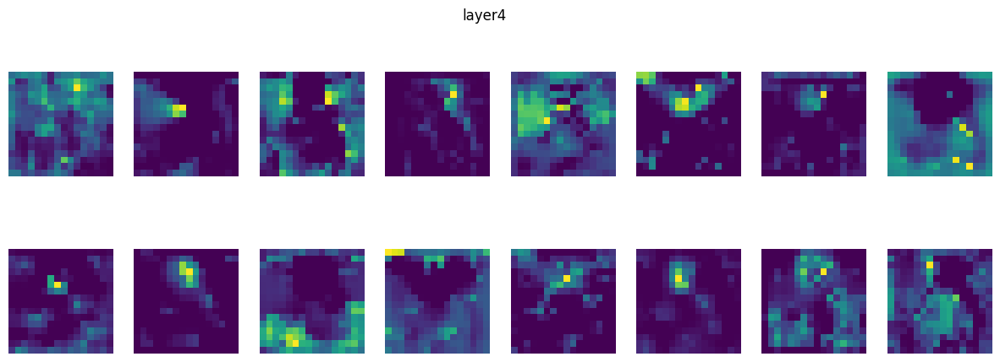

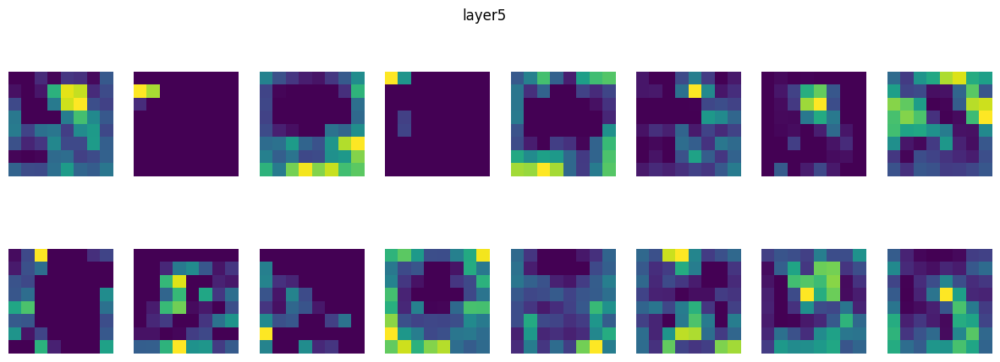

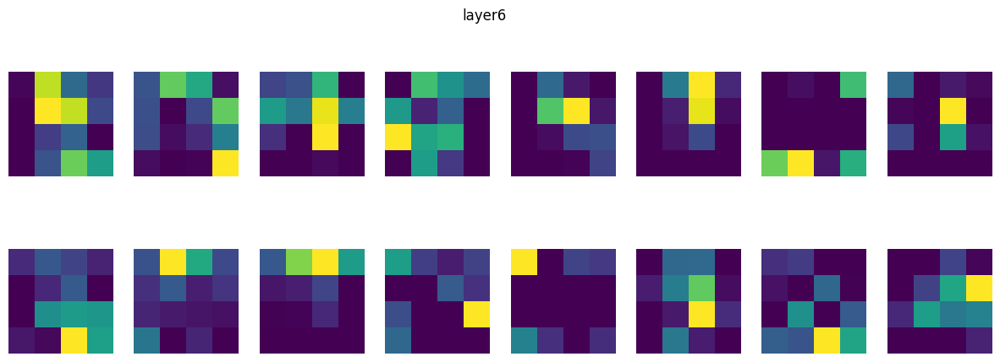

In [94]:
# Visualize the figure here, so it is exported nicely
plot_model_features()

# Network Performance

Got 1266 / 2000 correct of val set (63.30)
check acc <class 'torch.Tensor'> <class 'torch.Tensor'>


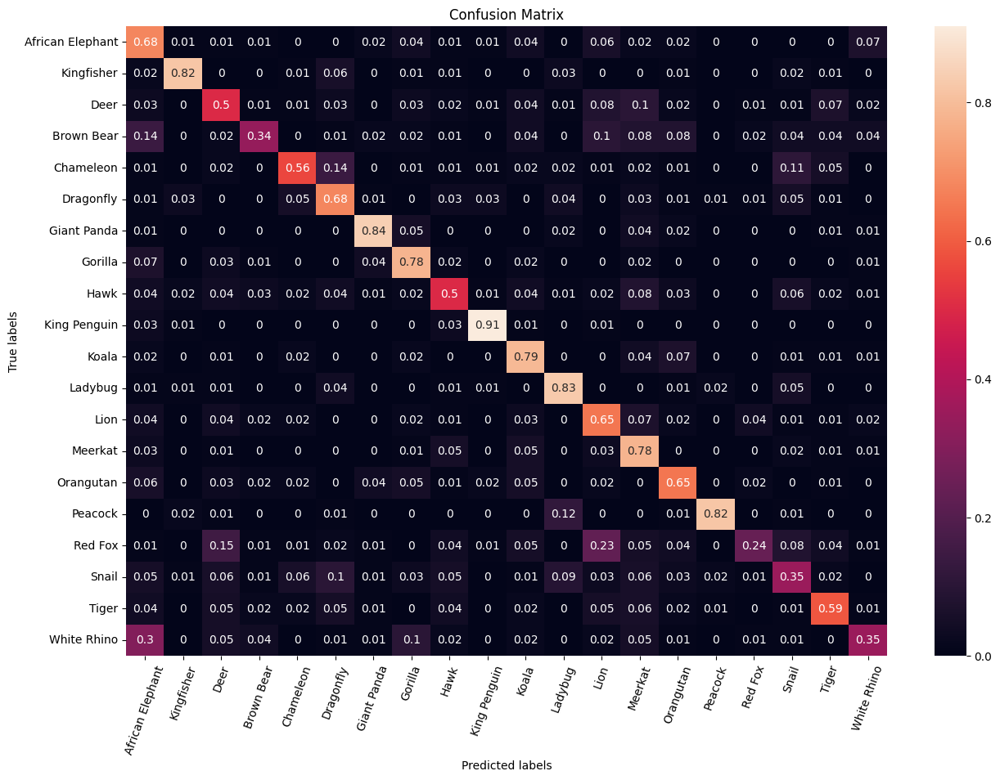

Predicted label ['White Rhino' 'Orangutan' 'Tiger' 'Dragonfly' 'Red Fox' 'White Rhino'
 'Meerkat' 'Snail' 'Deer']
True label ['Brown Bear' 'Koala' 'Orangutan' 'Kingfisher' 'Lion' 'African Elephant'
 'White Rhino' 'Hawk' 'Hawk']
Corresponding images are shown below


0.633

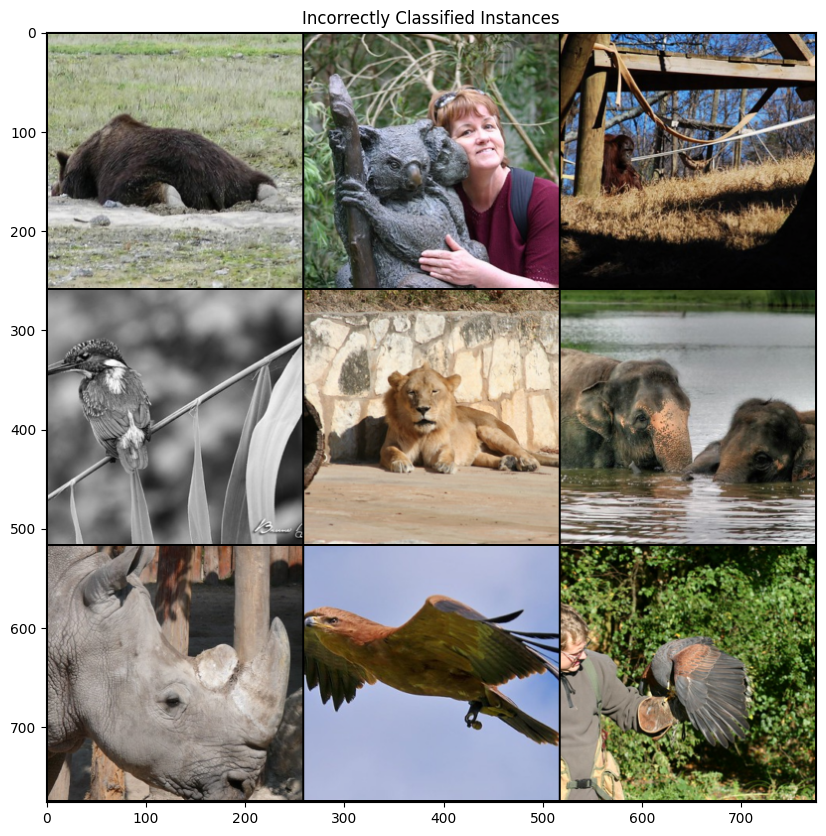

In [110]:
loader_test = DataLoader(test_dataset, batch_size=best_hyperparameters["batch_size"], shuffle=True, num_workers=2)
# Run once your have trained your final model
check_accuracy(loader_test, model, analysis=True)

# OOD evaluation

In [111]:
ON_COLAB = True

!wget https://zenodo.org/records/10424022/files/cartoons.zip?download=1

if ON_COLAB:
    !unzip /content/cartoons.zip?download=1 > /dev/null

else:
    !unzip cartoons.zip?download=1 > /dev/null

--2024-01-17 15:56:15--  https://zenodo.org/records/10424022/files/cartoons.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.184.103.159, 188.185.79.172, 188.184.98.238, ...
Connecting to zenodo.org (zenodo.org)|188.184.103.159|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1737267 (1.7M) [application/octet-stream]
Saving to: ‘cartoons.zip?download=1’

cartoons.zip?downlo 100%[===================>]   1.66M   621KB/s    in 2.7s    

2024-01-17 15:56:19 (621 KB/s) - ‘cartoons.zip?download=1’ saved [1737267/1737267]



In [112]:
mean = torch.Tensor([0.485, 0.456, 0.406]) # assuming same dist as imagenet
std = torch.Tensor([0.229, 0.224, 0.225])
transform = transforms.Compose(
        [
            transforms.Resize(256),
            transforms.CenterCrop(256),
            transforms.ToTensor(),
            transforms.Normalize(mean.tolist(), std.tolist()),
        ]

    )
cartoon_path = ('/content/' if ON_COLAB else '') + 'cartoons'


cartoon_dataset = datasets.ImageFolder(cartoon_path, transform=transform)

print(len(cartoon_dataset))

batch_size = 128

cartoon_loader = DataLoader(cartoon_dataset, batch_size=batch_size, shuffle=True, num_workers=2)

400


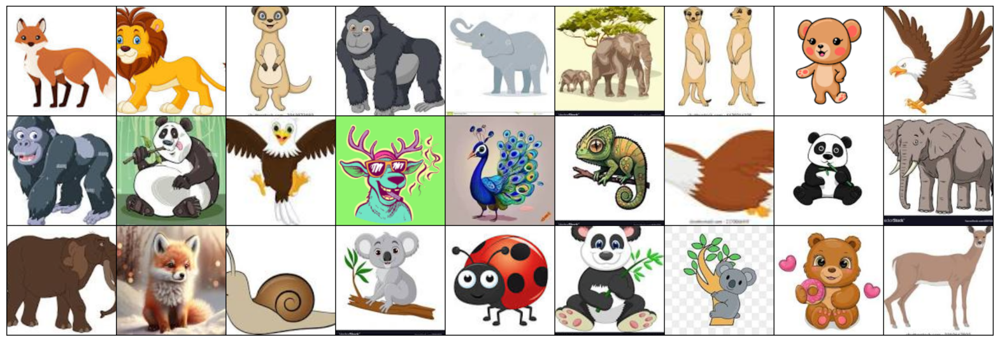

In [113]:
sample_inputs, _ = next(iter(cartoon_loader))
fixed_input = sample_inputs[:27, :, :, :]

img = make_grid(denorm(fixed_input), nrow=9, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)

plt.figure(figsize=(20,10))
plt.axis('off')
show(img)

Got 113 / 400 correct of val set (28.25)
check acc <class 'torch.Tensor'> <class 'torch.Tensor'>


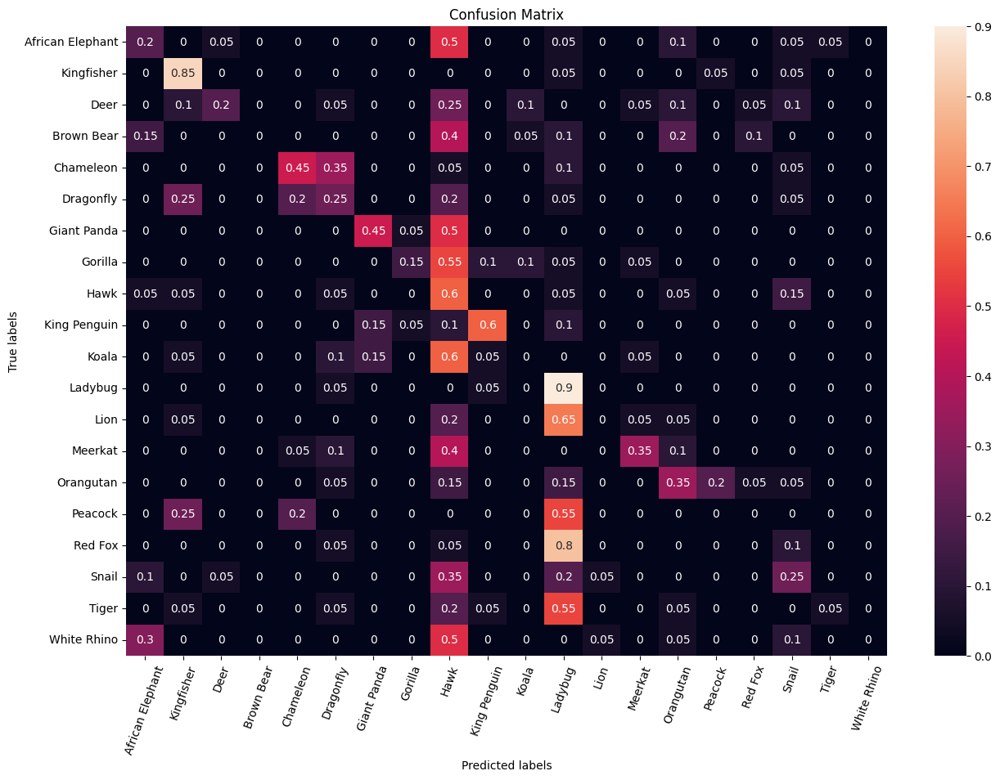

Predicted label ['Ladybug' 'Ladybug' 'King Penguin' 'Hawk' 'Orangutan' 'Ladybug'
 'Orangutan' 'Snail' 'Giant Panda']
True label ['Lion' 'Lion' 'Gorilla' 'Meerkat' 'African Elephant' 'Red Fox'
 'Brown Bear' 'Orangutan' 'King Penguin']
Corresponding images are shown below


0.2825

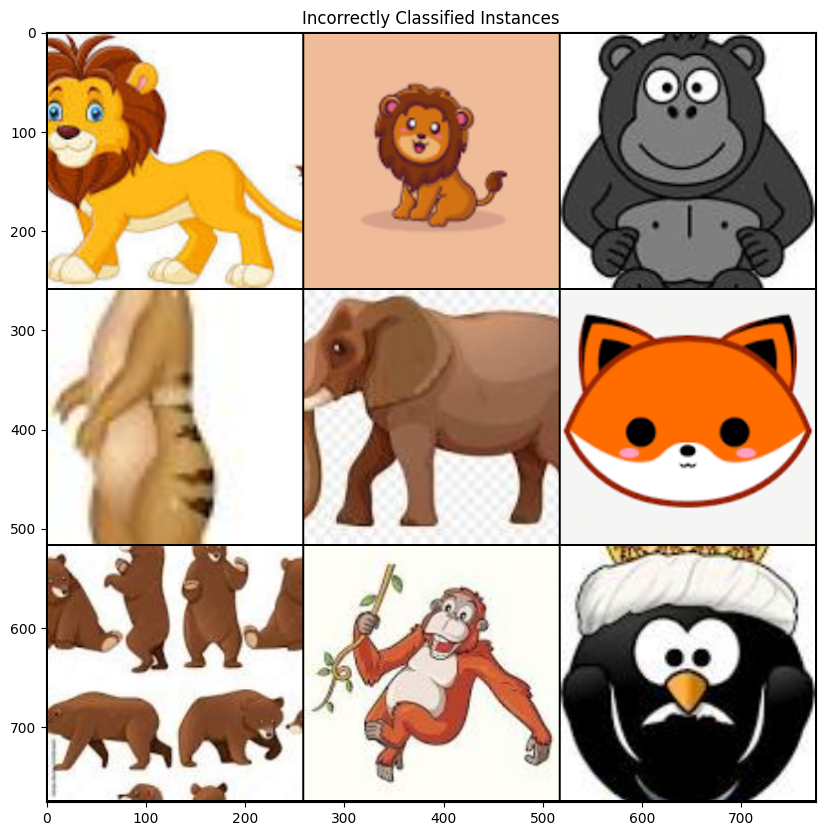

In [114]:
check_accuracy(cartoon_loader, model, analysis=True)

# Answer to questions

## Hyperparameter Search
Given such a network with a large number of trainable parameters, and a training set of a large number of data, what do you think is the best strategy for hyperparameter searching? (3 points)

| Hyperparameter   | Values                             |
|------------------|------------------------------------|
| method           | bayesian optimization                          |
| metric           | name: val_accuracy, goal: maximize |
| epochs           | value: 10                           |
| batch_size       | values: 32, 64, 96, 128             |
| num_blocks       | values: 2, 3, 4                     |
| optimizer        | values: adamax, adam, sgd           |
| lr               | distribution: uniform, max: 0.1, min: 0.0001 |
| weight_decay     | distribution: normal, mu: 5e-4, sigma: 1e-5 |


When dealing with a large network like ResNet and a sizable dataset, hyperparameter tuning becomes crucial for achieving optimal performance. Here are some strategies you can consider:

Random Search vs. Grid Search:

Random Search: It's often more efficient than grid search, as it randomly samples a subset of the hyperparameter space. This is beneficial when certain hyperparameters matter more than others.
Grid Search: Exhaustively searches through a predefined set of hyperparameter combinations. It ensures a more thorough exploration but might be computationally expensive.
Use Bayesian Optimization:

Bayesian optimization methods, such as Gaussian Processes or Tree-structured Parzen Estimators (TPE), can be efficient in finding optimal hyperparameters. They model the objective function and guide the search towards promising regions.
Coarse-to-Fine Strategy:

Start with a coarse search over a wide range of hyperparameters to identify a promising region. Then, perform a finer search in that region. This helps in narrowing down the search space efficiently.
Parallelize Hyperparameter Search:

Utilize parallel processing to evaluate multiple hyperparameter combinations simultaneously. This can significantly speed up the search process.
Automated Hyperparameter Tuning:

Consider using automated hyperparameter tuning tools like Hyperopt, Optuna, or Ray Tune. These frameworks provide algorithms for efficient hyperparameter optimization.
Transfer Learning:

If applicable, leverage pre-trained models as a starting point. Transfer learning can significantly reduce the amount of tuning needed, especially when dealing with large networks.
Use Learning Rate Schedulers:

Experiment with learning rate schedulers (e.g., StepLR, ReduceLROnPlateau) to find the optimal learning rate during training. Learning rate is a critical hyperparameter that can significantly impact model performance.
Regularization Techniques:

Experiment with different regularization techniques such as dropout, weight decay, and batch normalization. These can help in preventing overfitting.
Ensemble Learning:

Train multiple models with different hyperparameters and ensemble their predictions. This can improve overall performance and provide more robust results.
Monitoring and Early Stopping:

Monitor the training process and use techniques like early stopping to halt training when the model's performance on a validation set ceases to improve. This helps prevent overfitting and saves computational resources.
Remember to perform cross-validation to get a more reliable estimate of your model's performance for each set of hyperparameters. Additionally, keep track of the resources (time, computation power) available for hyperparameter tuning, as some methods might be more computationally intensive than others.

## Engineering Decisions
Detail which engineering decisions you made to boost the performance of the baseline results. Why do you think that they helped? (7 points)


Great! It seems like you've made several important engineering decisions to enhance the performance of your baseline results. Let's delve into each decision and discuss why they are likely to have a positive impact:

Data Augmentation:

Decision: Introducing data augmentation involves applying random transformations (such as rotation, scaling, and flipping) to the training data to artificially increase its diversity.
Reasoning: Data augmentation helps the model generalize better by exposing it to a wider range of variations in the input data. This is especially crucial when the training dataset is limited, as it helps prevent overfitting to the specific instances in the training set.
Dropout:

Decision: Dropout involves randomly setting a fraction of input units to zero during each update, which helps prevent overfitting.
Reasoning: By randomly dropping units during training, dropout acts as a form of regularization. It encourages the network to learn more robust and generalized features, reducing the risk of relying too heavily on specific neurons.
Learning Rate Scheduler:

Decision: Implementing a learning rate scheduler involves adjusting the learning rate during training, often decreasing it over time.
Reasoning: A learning rate scheduler can help the optimization process by allowing the model to converge faster during the initial stages while fine-tuning the learning rate later in training. This adaptive learning rate can help avoid overshooting and improve the overall convergence of the model.
Training for Longer + Early Stopping:

Decision: Extending the training duration while incorporating early stopping involves training the model for more epochs but monitoring performance on a validation set and stopping when performance plateaus.
Reasoning: Training for a longer duration gives the model more opportunities to learn intricate patterns in the data. Early stopping prevents overfitting by halting training when the model's performance on the validation set stops improving. This ensures that the model is not fine-tuned to noise in the training data.
By combining these strategies, you've created a more robust and well-regulated training process. Data augmentation and dropout directly address overfitting concerns, the learning rate scheduler aids in efficient optimization, and the combination of training for longer with early stopping balances model complexity and generalization. These decisions collectively contribute to improved model performance, especially in scenarios where data may be limited or noisy.

## Out of distribution evaluation
Lets see how your trained model performs when evaluated on cartoons of the 20 animal classes. Do not try and modify your model to perform well on this task, this is just a reflective exercise. How did your model perform at the task? Why do you think this was the case? Detail one method which you expect would improve model performance. (2 points)

Given that the model was not specifically trained on cartoons of the 20 animal classes, its performance on this task may be suboptimal. Neural networks, especially those trained on real-world images, might struggle when applied to cartoon-style images due to the significant visual differences between the two domains.

Performance Assessment:
The model is likely to face challenges in recognizing animals in cartoon form. Cartoon images often lack the realistic features, textures, and proportions present in the training data, leading to a domain shift. As a result, the model might struggle to generalize well to this new and distinct visual style, resulting in lower accuracy and predictive performance.

Possible Reasons for Suboptimal Performance:

Domain Shift: The model was trained on realistic images, and the cartoon-style images introduce a domain shift. The features and patterns the model learned from real images may not be relevant or transferable to cartoon images.

Lack of Cartoon-Specific Features: Cartoons often simplify and exaggerate visual elements, leading to a lack of fine-grained details present in realistic images. The model may not have learned to recognize animals in this simplified representation.

Texture and Color Differences: Cartoons typically have flat colors and simplified textures, unlike the diverse and detailed textures present in real-world images. The model may struggle with the differences in color distribution and texture patterns.

Improvement Strategy:
One method to improve model performance on cartoon-style images is to consider domain adaptation techniques. Specifically, training the model with a combination of real-world and cartoon-style images or employing domain adaptation algorithms could help the model better generalize across both domains.

Domain Adaptation Steps:

Collect Cartoon Dataset: Gather a dataset of cartoon-style images for the same set of 20 animal classes.
Combine Real and Cartoon Data: Create a training dataset that includes a mix of real-world and cartoon images. Ensure that the classes are balanced.
Fine-Tuning or Domain Adaptation: Fine-tune the existing model on the combined dataset or use domain adaptation techniques to help the model adapt to the specific visual characteristics of cartoon-style images.
Evaluate Performance: Assess the model's performance on a separate validation set of cartoon images to ensure improved generalization.
By explicitly addressing the domain shift and training the model with data that more closely resembles the target domain, the model can learn features that are relevant to both realistic and cartoon-style images, potentially enhancing its performance on the task.

## Feature maps
Compare the feature maps from low-level layers to high-level layers, what do you observe? (4 points)


The observations on feature maps across different layers of a neural network generally follow a pattern, with low-level layers capturing simple and local patterns, and high-level layers capturing more complex and abstract representations. Here are common observations:

Low-Level Layers:

Local Patterns: Feature maps in low-level layers tend to capture local patterns and basic structures within the input data. These patterns could include edges, corners, or simple textures.
High Spatial Resolution: Low-level layers typically preserve high spatial resolution, meaning the feature maps retain fine-grained details from the input.
Mid-Level Layers:

Intermediate Features: As you move to mid-level layers, feature maps start to capture more complex patterns that involve combinations of low-level features. These could represent parts of objects or textures.
Increased Abstraction: Mid-level layers begin to abstract away from the raw pixel values and focus on higher-level visual elements. They might respond to more sophisticated shapes or object parts.
High-Level Layers:

Global Patterns and Concepts: Feature maps in high-level layers are sensitive to global patterns, object parts, or even entire objects. They represent more abstract and complex visual concepts.
Low Spatial Resolution: High-level layers often have lower spatial resolution because they are designed to capture global context rather than fine details. The receptive fields become larger as you move up the layers.
Semantic Information:

Semantically Rich Representations: In high-level layers, feature maps are semantically rich and contain information relevant to the overall classification or task. Neurons may respond to specific object categories or higher-level concepts.
Invariance to Transformations: High-level layers tend to develop some degree of invariance to variations like scale, orientation, or lighting conditions, making the model more robust.
Observations Across Layers:

Progressive Abstraction: As you move through the layers, the network progressively abstracts information. It transforms raw pixel values into increasingly sophisticated and abstract representations.
Hierarchical Structure: The hierarchical structure of the feature maps reflects the hierarchical nature of the visual information in the input data.
Understanding these observations helps in interpreting how neural networks learn and represent information. It also provides insights into what kind of features the network is focusing on at different levels of abstraction, aiding in model interpretation and debugging.

## Performance analysis
Use the training log, reported test set accuracy and the feature maps, analyse the performance of your network. If you think the performance is sufficiently good, explain why; if not, what might be the problem and how can you improve the performance? (4 points)

Analyzing Performance:

Training Log:

Training Loss: Check if the training loss decreases over time. A decreasing loss indicates that the model is learning from the training data.
Training Accuracy: Monitor the training accuracy. It should generally increase, indicating that the model is fitting the training data.
Test Set Accuracy:

Generalization: Examine the test set accuracy. If the accuracy is high, it suggests that the model has generalized well to unseen data. However, a large gap between training and test accuracy may indicate overfitting.
Feature Maps:

Visualization: Visualize feature maps from different layers. Ensure that the low-level layers capture basic patterns, mid-level layers capture more complex features, and high-level layers capture abstract representations.
Activation Patterns: Check if the feature maps respond to relevant parts of the input data. For instance, in a classification task, feature maps in higher layers might show strong activations for specific object categories.
Possible Issues and Improvements:

Overfitting:

Issue: If the training accuracy is high, but the test accuracy is low, it could indicate overfitting. The model may be too complex, capturing noise in the training data.
Improvement: Regularize the model using techniques like dropout, weight decay, or reduce model complexity. Additionally, consider increasing the amount of training data.
Underfitting:

Issue: If both training and test accuracies are low, the model may be too simple to capture the underlying patterns in the data.
Improvement: Increase model complexity, add more layers, or adjust hyperparameters. Ensure that the model has sufficient capacity to learn from the data.
Data Quality:

Issue: Poor performance might be due to insufficient or noisy training data.
Improvement: Collect more high-quality training data. Clean the data to remove noise or outliers.
Hyperparameter Tuning:

Issue: Inadequate hyperparameter choices, such as learning rate or batch size, can impact training.
Improvement: Conduct a systematic hyperparameter search to find optimal values. Use techniques like random search or Bayesian optimization.
Class Imbalance:

Issue: If there is a significant class imbalance in the dataset, the model may be biased towards the majority class.
Improvement: Balance the class distribution in the training data. Use techniques like oversampling, undersampling, or class-weighted loss.
Domain Shift:

Issue: If the test set comes from a different distribution than the training set, performance may suffer.
Improvement: Incorporate domain adaptation techniques, or ensure that the training set is representative of the test set.
Without specific details on the provided metrics and visualizations, these are general guidelines for assessing and improving model performance. Tailoring solutions to your specific context would require a more detailed analysis of your data, model architecture, and training process.

# Others

## Check trained model's predictions

In [ ]:
# Get the class names
class_names = train_dataset.classes

# Print the class names
print("Class names:", class_names)

In [ ]:
dataiter = iter(test_loader)
images, labels = next(dataiter)
images, labels = images[:4], labels[:4]
# print images
imshow(torchvision.utils.make_grid(images))
print('GroundTruth: ', ' '.join(f'{class_names[labels[j]]:5s}' for j in range(4)))

In [ ]:
outputs = model(images.to(device=device, dtype=dtype))
_, predicted = torch.max(outputs, 1)

print('Predicted: ', ' '.join(f'{class_names[predicted[j]]:5s}'
                              for j in range(4)))

In [ ]:
# prepare to count predictions for each class
correct_pred = {classname: 0 for classname in class_names}
total_pred = {classname: 0 for classname in class_names}

# again no gradients needed
with torch.no_grad():
    for data in test_loader:
        images, labels = data[0].to(device), data[1].to(device)
        outputs = model(images)
        _, predictions = torch.max(outputs, 1)
        # collect the correct predictions for each class
        for label, prediction in zip(labels, predictions):
            if label == prediction:
                correct_pred[class_names[label]] += 1
            total_pred[class_names[label]] += 1


# print accuracy for each class
for classname, correct_count in correct_pred.items():
    accuracy = 100 * float(correct_count) / total_pred[classname]
    print(f'Accuracy for class: {classname:5s} is {accuracy:.1f} %')

## Final output of model methods

### Utils

In [ ]:
USE_GPU = True
dtype = torch.float32
# current_directory = '/Users/lorenzostigliano/Documents/Imperial/Spring Term/Deep Learning/DL_CW_1_ls1121/models/'

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [ ]:
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def denorm(x):
    '''
    Function to reverse the normalization so that we can visualise the outputs
    '''
    x = unnormalize(x)
    x = x.view(x.size(0), 3, 256, 256)
    return x

def show(img):
    '''
    function to visualise tensors
    '''
    if torch.cuda.is_available():
        img = img.cpu()
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)).clip(0, 1))

sample_inputs, _ = next(iter(loader_val))
fixed_input = sample_inputs[:27, :, :, :]

img = make_grid(denorm(fixed_input), nrow=9, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(20,10))
plt.axis('off')
show(img)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

def confusion(preds, y):
  labels = ['African Elephant', 'Kingfisher', 'Deer','Brown Bear', 'Chameleon', 'Dragonfly',
    'Giant Panda', 'Gorilla', 'Hawk', 'King Penguin', 'Koala', 'Ladybug', 'Lion',
    'Meerkat', 'Orangutan', 'Peacock', 'Red Fox', 'Snail', 'Tiger', 'White Rhino']
  # Plotting the confusion matrix
  cm = confusion_matrix(y.cpu().numpy(), preds.cpu().numpy(), normalize='true')
  fig, ax= plt.subplots(1, 1, figsize=(15,10))
  sns.heatmap(cm, annot=True, ax = ax); #annot=True to annotate cells

  # labels, title and ticks
  ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
  ax.set_title('Confusion Matrix');
  ax.xaxis.set_ticklabels(labels, rotation = 70); ax.yaxis.set_ticklabels(labels, rotation=0);
  plt.show()

def incorrect_preds(preds, y, test_img):
  labels = ['African Elephant', 'Kingfisher', 'Deer','Brown Bear', 'Chameleon', 'Dragonfly',
    'Giant Panda', 'Gorilla', 'Hawk', 'King Penguin', 'Koala', 'Ladybug', 'Lion',
    'Meerkat', 'Orangutan', 'Peacock', 'Red Fox', 'Snail', 'Tiger', 'White Rhino']
  # lets see a sample of the images which were classified incorrectly!
  correct = (preds == y).float()
  test_labels_check = correct.cpu().numpy()
  incorrect_indexes = np.where(test_labels_check == 0)

  test_img = test_img.cpu()
  samples = make_grid(denorm(test_img[incorrect_indexes][:9]), nrow=3,
                      padding=2, normalize=False, value_range=None,
                      scale_each=False, pad_value=0)
  plt.figure(figsize = (20,10))
  plt.title('Incorrectly Classified Instances')
  show(samples)
  labels = np.asarray(labels)
  print('Predicted label',labels[preds[incorrect_indexes].cpu().numpy()[:9]])
  print('True label', labels[y[incorrect_indexes].cpu().numpy()[:9]])
  print('Corresponding images are shown below')

def check_accuracy(loader, model, analysis=False):
    # function for test accuracy on validation and test set
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for t, (x, y) in enumerate(loader):
            x = x.to(device=device, dtype=dtype)  # move to device
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            if t == 0 and analysis:
              stack_labels = y
              stack_predicts = preds
            elif analysis:
              stack_labels = torch.cat([stack_labels, y], 0)
              stack_predicts = torch.cat([stack_predicts, preds], 0)
        acc = float(num_correct) / num_samples
        print('Got %d / %d correct of set (%.2f)' % (num_correct, num_samples, 100 * acc))
        if analysis:
          print('check acc', type(stack_predicts), type(stack_labels))
          confusion(stack_predicts, stack_labels)
          incorrect_preds(preds, y, x)
        return float(acc)


In [ ]:
import matplotlib.pyplot as plt

def plot_model_features():
    fig = plt.tight_layout()
    activation = {}
    def get_activation(name):
        def hook(model, input, output):
            activation[name] = output.detach()
        return hook
    vis_labels = ['conv1', 'layer1', 'layer2', 'layer3', 'layer4', 'layer5', 'layer6']

    for l in vis_labels:
        getattr(model, l).register_forward_hook(get_activation(l))

    data, _ = test_dataset[999]
    data = data.unsqueeze_(0).to(device = device, dtype = dtype)
    output = model(data)

    for idx, l in enumerate(vis_labels):
        act = activation[l].squeeze()

        # only showing the first 16 channels
        ncols, nrows = 8, 2

        fig, axarr = plt.subplots(nrows, ncols, figsize=(15,5))
        fig.suptitle(l)

        count = 0
        for i in range(nrows):
            for j in range(ncols):
                axarr[i, j].imshow(act[count].cpu())
                axarr[i, j].axis('off')
                count += 1

### Resnet architecture

In [ ]:
# define resnet building blocks
class ResidualBlock(nn.Module):
    def __init__(self, inchannel, outchannel, activation_type, stride=1, groups=2):

        super(ResidualBlock, self).__init__()
        self.activation_type = activation_type
        if self.activation_type == "ReLu":
          self.left = nn.Sequential(Conv2d(inchannel, outchannel, kernel_size=3,
                                          stride=stride, padding=1, bias=False,
                                          groups=groups),
                                    nn.BatchNorm2d(outchannel),
                                    nn.ReLU(inplace=True),
                                    Conv2d(outchannel, outchannel, kernel_size=3,
                                          stride=1, padding=1, bias=False,
                                          groups=groups),
                                    nn.BatchNorm2d(outchannel),
                                    # nn.Dropout(p=drop_prob)
                                    )
        else:
          self.left = nn.Sequential(Conv2d(inchannel, outchannel, kernel_size=3,
                                stride=stride, padding=1, bias=False,
                                groups=groups),
                          nn.BatchNorm2d(outchannel),
                          nn.LeakyReLU(inplace=True),
                          Conv2d(outchannel, outchannel, kernel_size=3,
                                stride=1, padding=1, bias=False,
                                groups=groups),
                          nn.BatchNorm2d(outchannel))
        self.shortcut = nn.Sequential()
        if stride != 1 or inchannel != outchannel:
            self.shortcut = nn.Sequential(Conv2d(inchannel, outchannel,
                                                 kernel_size=1, stride=stride,
                                                 padding = 0, bias=False),
                                          nn.BatchNorm2d(outchannel),
                                          # nn.Dropout(p=drop_prob)
                                          )

    def forward(self, x):
        out = self.left(x)
        out += self.shortcut(x)
        if self.activation_type == "ReLu":
          out = F.relu(out)
        else:
          out = F.leaky_relu(out)
        return out

class ResNet(nn.Module):
    def __init__(self, ResidualBlock, architecture, activation_type, num_classes = 20):
        super(ResNet, self).__init__()

        self.inchannel = 16
        self.activation_type = activation_type
        self.architecture = architecture

        if self.activation_type == "ReLu":
          self.conv1 = nn.Sequential(
              Conv2d(3, 16, kernel_size = 3, stride = 1,padding = 1, bias = False),
              nn.BatchNorm2d(16),
              nn.ReLU(),
              # nn.Dropout(p=drop_prob)
              )
        else:
          self.conv1 = nn.Sequential(
              Conv2d(3, 16, kernel_size = 3, stride = 1,padding = 1, bias = False),
              nn.BatchNorm2d(16),
              nn.LeakyReLU())

        self.layer1 = self.make_layer(ResidualBlock, architecture[0][0],  architecture[0][1], stride =  architecture[0][2])
        self.layer2 = self.make_layer(ResidualBlock, architecture[1][0],  architecture[1][1], stride =  architecture[1][2])
        self.layer3 = self.make_layer(ResidualBlock, architecture[2][0],  architecture[2][1], stride =  architecture[2][2])
        self.layer4 = self.make_layer(ResidualBlock, architecture[3][0],  architecture[3][1], stride =  architecture[3][2])
        self.layer5 = self.make_layer(ResidualBlock, architecture[4][0],  architecture[4][1], stride =  architecture[4][2])
        self.layer6 = self.make_layer(ResidualBlock, architecture[5][0],  architecture[5][1], stride =  architecture[5][2])
        self.maxpool = MaxPool2d(4)
        self.fc = nn.Linear(512, num_classes)

    def make_layer(self, block, channels, num_blocks, stride):

        strides = [stride] + [1] * (num_blocks - 1)
        layers = []
        for stride in strides:
            layers.append(block(self.inchannel, channels, self.activation_type, stride, groups=self.architecture[0][3]))
            self.inchannel = channels

        return nn.Sequential(*layers)

    def forward(self, x):

        x = self.conv1(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        x = self.layer6(x)
        x = self.maxpool(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

# please do not change the name of this class
def MyResNet():
    #Final model architecture defined
    # channels, num_blocks, stride, groups
    architecture = [
    [16, 2, 2, 2],
    [32, 2, 2, 2],
    [64, 3, 2, 2],
    [128, 4, 2, 2],
    [256, 4, 2, 2],
    [512, 3, 2, 2],
    ]
    return ResNet(ResidualBlock, architecture, "ReLu")

In [ ]:
!ls

 NaturalImageNetTest		       NaturalImageNetTrain		      sample_data
'NaturalImageNetTest.zip?download=1'  'NaturalImageNetTrain.zip?download=1'


### Dataloaders

In [ ]:
# transform = transforms.Compose(
#     [transforms.ToTensor(),
#      transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

# data_transforms = {
#     'train': transforms.Compose([
#         transforms.RandomResizedCrop(224),
#         transforms.RandomHorizontalFlip(),
#         transforms.ToTensor(),
#         transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
#     ]),
#     'val': transforms.Compose([
#         transforms.Resize(256),
#         transforms.CenterCrop(224),
#         transforms.ToTensor(),
#         transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
#     ]),
# }


# data_transforms = {
#     'train': T.Compose([
#         T.RandomPerspective(distortion_scale=0.25, p=0.4, interpolation=3),
#         T.RandomRotation(5),
#         T.RandomAffine(0, translate=(0, 0.05)),
#         T.RandomHorizontalFlip(p=0.5),
#         T.ToTensor(),
#         T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
#     ]),
#     'val': T.Compose([
#         T.ToTensor(),
#         T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
#     ]),
#     'test': T.Compose([
#         T.ToTensor(),
#         T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
#     ]),
# }

In [ ]:
USE_GPU = True
dtype = torch.float32

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
    print("Using GPU")
else:
    device = torch.device('cpu')

In [ ]:
# set the seed for reproducibility
rng_seed = 90
torch.manual_seed(rng_seed)

mean = torch.Tensor([0.485, 0.456, 0.406])
std = torch.Tensor([0.229, 0.224, 0.225])

transform = transforms.Compose(
        [
            transforms.Resize(256),
            transforms.CenterCrop(256),
            transforms.ToTensor(),
            transforms.Normalize(mean.tolist(), std.tolist()),
        ]
    )

# train_path = '/Users/lorenzostigliano/Documents/Imperial/Spring Term/Deep Learning/DL_CW_1_ls1121/NaturalImageNetTrain'
# test_path = '/Users/lorenzostigliano/Documents/Imperial/Spring Term/Deep Learning/DL_CW_1_ls1121/NaturalImageNetTest'
train_path = '/content/NaturalImageNetTrain'
test_path = '/content/NaturalImageNetTest'

# train_dataset = datasets.ImageFolder(train_path, transform=transform)
# test_dataset = datasets.ImageFolder(test_path, transform=transform)
train_dataset = datasets.ImageFolder(train_path, transform=transform)
test_dataset = datasets.ImageFolder(test_path, transform=transform)

# Create train val split
n = len(train_dataset)
n_val = int(n/10)

train_set, val_set = torch.utils.data.random_split(train_dataset, [n-n_val, n_val])
print(len(train_set), len(val_set), len(test_dataset))

# The number of images to process in one go. If you run out of GPU
# memory reduce this number!
batch_size = 128
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=True, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=2)

17986 1998 2000


In [ ]:
# Get the class names
class_names = train_dataset.classes

# Print the class names
print("Class names:", class_names)

Class names: ['African elephant', 'Eurasiankingfisher', 'Virginia deer', 'brown bear', 'chameleon', 'dragonfly', 'giant panda', 'gorilla', 'hawk', 'king penguin', 'koala', 'ladybug', 'lion', 'meerkat', 'orangutan', 'peacock', 'red fox', 'snail', 'tiger', 'white rhinoceros']


In [ ]:
import torchvision

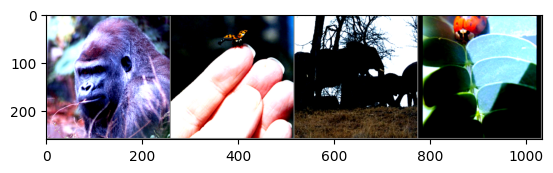

gorilla ladybug African elephant ladybug


In [ ]:
# get some random training images
dataiter = iter(train_loader)
images, labels = next(dataiter)
images, labels = images[:4], labels[:4]
def imshow(img):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

# show images
imshow(torchvision.utils.make_grid(images))
# print labels
print(' '.join(f'{class_names[labels[j]]:5s}' for j in range(4)))

### Training

In [ ]:
# Data Augmentation for training samples:
#   - Random Distortion
#   - Random Rotation
#   - Random Translation
#   - Coin toss horizontal flip.
#   - Normalise images as per specs.

# Dropout:
#   - Implemented a 7% probability dropout to improve robustness of performance
#     on test set.

# Optimiser:
#   - Implemented an Adam optimiser with initial learning rate of 9e-4.
#   - I have not any included weight_decay as I have implemented schedulers.

# Scheduler:
#   - Added two schedulers to reduce the learning rate as the network improves
#     throughout training epochs.
#   - Fine tuned the epoch on which the first one (first_sched) should happen
#     and rate of decrease (gamma).
#   - Fine tuned the epoch on which the second one (sec_sched) should happen
#     and rate of decrease (gamma). For this one I found that a smaller
#     decrease (larger gamma) at multiple times was more effective.

In [ ]:
import torch.optim as optim

criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

In [ ]:
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.5, last_epoch=-1, verbose=False)

In [ ]:
# Additional parameters are returned by train_part and check_accuracy to plot
# confusion matrix and other visualisations.
if OPTIMISE_AND_VISUALISE:
    acc_curve, loss_curve = train_part(model, optimizer, epochs = num_epochs,
                                       scheduler1=first_sched, scheduler2=sec_sched)
    # report test set accuracy
    all_preds, all_targets, acc_test = check_accuracy(loader_test, model)

else:
    train_part(model, optimizer, epochs = 10, scheduler1=first_sched, scheduler2=sec_sched)

    # report test set accuracy
    check_accuracy(loader_test, model)

In [ ]:
model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

In [ ]:
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=25)

In [ ]:
for epoch in range(2):  # loop over the dataset multiple times

    running_loss = 0.0
    for i, data in enumerate(trainloader, 0):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        if i % 2000 == 1999:    # print every 2000 mini-batches
            print(f'[{epoch + 1}, {i + 1:5d}] loss: {running_loss / 2000:.3f}')
            running_loss = 0.0

print('Finished Training')

In [ ]:
PATH = './cifar_net.pth'
torch.save(net.state_dict(), PATH)

In [ ]:
net = Net()
net.load_state_dict(torch.load(PATH))
# Create a new instance of FashionMNISTModelV2 (the same class as our saved state_dict())
# Note: loading model will error if the shapes here aren't the same as the saved version
loaded_model_2 = FashionMNISTModelV2(input_shape=1,
                                    hidden_units=10, # try changing this to 128 and seeing what happens
                                    output_shape=10)

# Load in the saved state_dict()
loaded_model_2.load_state_dict(torch.load(f=MODEL_SAVE_PATH))

# Send model to GPU
loaded_model_2 = loaded_model_2.to(device)

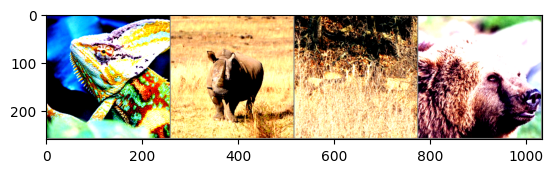

GroundTruth:  chameleon white rhinoceros Virginia deer brown bear


In [ ]:
dataiter = iter(test_loader)
images, labels = next(dataiter)
images, labels = images[:4], labels[:4]
# print images
imshow(torchvision.utils.make_grid(images))
print('GroundTruth: ', ' '.join(f'{class_names[labels[j]]:5s}' for j in range(4)))

In [ ]:
outputs = model(images.to(device=device, dtype=dtype))
_, predicted = torch.max(outputs, 1)

print('Predicted: ', ' '.join(f'{class_names[predicted[j]]:5s}'
                              for j in range(4)))

Predicted:  red fox red fox red fox red fox


In [ ]:
# prepare to count predictions for each class
correct_pred = {classname: 0 for classname in class_names}
total_pred = {classname: 0 for classname in class_names}

# again no gradients needed
with torch.no_grad():
    for data in test_loader:
        images, labels = data[0].to(device), data[1].to(device)
        outputs = model(images)
        _, predictions = torch.max(outputs, 1)
        # collect the correct predictions for each class
        for label, prediction in zip(labels, predictions):
            if label == prediction:
                correct_pred[class_names[label]] += 1
            total_pred[class_names[label]] += 1


# print accuracy for each class
for classname, correct_count in correct_pred.items():
    accuracy = 100 * float(correct_count) / total_pred[classname]
    print(f'Accuracy for class: {classname:5s} is {accuracy:.1f} %')

Accuracy for class: African elephant is 0.0 %
Accuracy for class: Eurasiankingfisher is 0.0 %
Accuracy for class: Virginia deer is 0.0 %
Accuracy for class: brown bear is 0.0 %
Accuracy for class: chameleon is 0.0 %
Accuracy for class: dragonfly is 0.0 %
Accuracy for class: giant panda is 0.0 %
Accuracy for class: gorilla is 0.0 %
Accuracy for class: hawk  is 0.0 %
Accuracy for class: king penguin is 0.0 %
Accuracy for class: koala is 0.0 %
Accuracy for class: ladybug is 0.0 %
Accuracy for class: lion  is 0.0 %
Accuracy for class: meerkat is 0.0 %
Accuracy for class: orangutan is 0.0 %
Accuracy for class: peacock is 0.0 %
Accuracy for class: red fox is 88.0 %
Accuracy for class: snail is 0.0 %
Accuracy for class: tiger is 0.0 %
Accuracy for class: white rhinoceros is 0.0 %


In [ ]:
def train_step(model: torch.nn.Module,
               data_loader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               optimizer: torch.optim.Optimizer,
               accuracy_fn,
               device: torch.device = device):
    train_loss, train_acc = 0, 0
    model.to(device)
    for batch, (X, y) in enumerate(data_loader):
        # Send data to GPU
        X, y = X.to(device), y.to(device)

        # 1. Forward pass
        y_pred = model(X)

        # 2. Calculate loss
        loss = loss_fn(y_pred, y)
        train_loss += loss
        train_acc += accuracy_fn(y_true=y,
                                 y_pred=y_pred.argmax(dim=1)) # Go from logits -> pred labels

        # 3. Optimizer zero grad
        optimizer.zero_grad()

        # 4. Loss backward
        loss.backward()

        # 5. Optimizer step
        optimizer.step()

    # Calculate loss and accuracy per epoch and print out what's happening
    train_loss /= len(data_loader)
    train_acc /= len(data_loader)
    print(f"Train loss: {train_loss:.5f} | Train accuracy: {train_acc:.2f}%")

def test_step(data_loader: torch.utils.data.DataLoader,
              model: torch.nn.Module,
              loss_fn: torch.nn.Module,
              accuracy_fn,
              device: torch.device = device):
    test_loss, test_acc = 0, 0
    model.to(device)
    model.eval() # put model in eval mode
    # Turn on inference context manager
    with torch.inference_mode():
        for X, y in data_loader:
            # Send data to GPU
            X, y = X.to(device), y.to(device)

            # 1. Forward pass
            test_pred = model(X)

            # 2. Calculate loss and accuracy
            test_loss += loss_fn(test_pred, y)
            test_acc += accuracy_fn(y_true=y,
                y_pred=test_pred.argmax(dim=1) # Go from logits -> pred labels
            )

        # Adjust metrics and print out
        test_loss /= len(data_loader)
        test_acc /= len(data_loader)
        print(f"Test loss: {test_loss:.5f} | Test accuracy: {test_acc:.2f}%\n")

In [ ]:
torch.manual_seed(42)

# Measure time
from timeit import default_timer as timer
train_time_start_on_gpu = timer()

epochs = 3
for epoch in tqdm(range(epochs)):
    print(f"Epoch: {epoch}\n---------")
    train_step(data_loader=train_dataloader,
        model=model_1,
        loss_fn=loss_fn,
        optimizer=optimizer,
        accuracy_fn=accuracy_fn
    )
    test_step(data_loader=test_dataloader,
        model=model_1,
        loss_fn=loss_fn,
        accuracy_fn=accuracy_fn
    )

train_time_end_on_gpu = timer()
total_train_time_model_1 = print_train_time(start=train_time_start_on_gpu,
                                            end=train_time_end_on_gpu,
                                            device=device)

In [ ]:
def train_model(model, optimizer, epochs=1, print_every=100):
    """
    Train a model on NaturalImageNet using the PyTorch Module API.
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for

    Returns: Nothing, but prints model accuracies during training.
    """
    val_acc_per_epoch = []
    params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print("Total number of parameters is: {}".format(params))
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    for e in range(epochs):
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            loss = F.cross_entropy(scores, y)
            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()
            loss.backward()
            # Update the parameters of the model using the gradients
            optimizer.step()
            if t % print_every == 0 and print_every == 100:
                print('Epoch: %d, Iteration %d, loss = %.4f' % (e, t, loss.item()))
        print(f"Epoch:{e}")
        acc = check_accuracy(val_loader, model)
        print(acc)
        val_acc_per_epoch.append(acc)
    return val_acc_per_epoch

In [ ]:
# Import tqdm for progress bar
from tqdm.auto import tqdm

# Set the seed and start the timer
torch.manual_seed(42)
train_time_start_on_cpu = timer()

# Set the number of epochs (we'll keep this small for faster training times)
epochs = 3

# Create training and testing loop
for epoch in tqdm(range(epochs)):
    print(f"Epoch: {epoch}\n-------")
    ### Training
    train_loss = 0
    # Add a loop to loop through training batches
    for batch, (X, y) in enumerate(train_dataloader):
        model_0.train()
        # 1. Forward pass
        y_pred = model_0(X)

        # 2. Calculate loss (per batch)
        loss = loss_fn(y_pred, y)
        train_loss += loss # accumulatively add up the loss per epoch

        # 3. Optimizer zero grad
        optimizer.zero_grad()

        # 4. Loss backward
        loss.backward()

        # 5. Optimizer step
        optimizer.step()

        # Print out how many samples have been seen
        if batch % 400 == 0:
            print(f"Looked at {batch * len(X)}/{len(train_dataloader.dataset)} samples")

    # Divide total train loss by length of train dataloader (average loss per batch per epoch)
    train_loss /= len(train_dataloader)

    ### Testing
    # Setup variables for accumulatively adding up loss and accuracy
    test_loss, test_acc = 0, 0
    model_0.eval()
    with torch.inference_mode():
        for X, y in test_dataloader:
            # 1. Forward pass
            test_pred = model_0(X)

            # 2. Calculate loss (accumatively)
            test_loss += loss_fn(test_pred, y) # accumulatively add up the loss per epoch

            # 3. Calculate accuracy (preds need to be same as y_true)
            test_acc += accuracy_fn(y_true=y, y_pred=test_pred.argmax(dim=1))

        # Calculations on test metrics need to happen inside torch.inference_mode()
        # Divide total test loss by length of test dataloader (per batch)
        test_loss /= len(test_dataloader)

        # Divide total accuracy by length of test dataloader (per batch)
        test_acc /= len(test_dataloader)

    ## Print out what's happening
    print(f"\nTrain loss: {train_loss:.5f} | Test loss: {test_loss:.5f}, Test acc: {test_acc:.2f}%\n")

# Calculate training time
train_time_end_on_cpu = timer()
total_train_time_model_0 = print_train_time(start=train_time_start_on_cpu,
                                           end=train_time_end_on_cpu,
                                           device=str(next(model_0.parameters()).device))

In [ ]:
def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title(f'predicted: {class_names[preds[j]]}')
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

### Evaluation

In [ ]:
# Move values to device
torch.manual_seed(42)
def eval_model(model: torch.nn.Module,
               data_loader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               accuracy_fn,
               device: torch.device = device):
    """Evaluates a given model on a given dataset.

    Args:
        model (torch.nn.Module): A PyTorch model capable of making predictions on data_loader.
        data_loader (torch.utils.data.DataLoader): The target dataset to predict on.
        loss_fn (torch.nn.Module): The loss function of model.
        accuracy_fn: An accuracy function to compare the models predictions to the truth labels.
        device (str, optional): Target device to compute on. Defaults to device.

    Returns:
        (dict): Results of model making predictions on data_loader.
    """
    loss, acc = 0, 0
    model.eval()
    with torch.inference_mode():
        for X, y in data_loader:
            # Send data to the target device
            X, y = X.to(device), y.to(device)
            y_pred = model(X)
            loss += loss_fn(y_pred, y)
            acc += accuracy_fn(y_true=y, y_pred=y_pred.argmax(dim=1))

        # Scale loss and acc
        loss /= len(data_loader)
        acc /= len(data_loader)
    return {"model_name": model.__class__.__name__, # only works when model was created with a class
            "model_loss": loss.item(),
            "model_acc": acc}

# Calculate model 1 results with device-agnostic code
model_1_results = eval_model(model=model_1, data_loader=test_dataloader,
    loss_fn=loss_fn, accuracy_fn=accuracy_fn,
    device=device
)
model_1_results

In [ ]:
torch.manual_seed(42)
def eval_model(model: torch.nn.Module,
               data_loader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               accuracy_fn):
    """Returns a dictionary containing the results of model predicting on data_loader.

    Args:
        model (torch.nn.Module): A PyTorch model capable of making predictions on data_loader.
        data_loader (torch.utils.data.DataLoader): The target dataset to predict on.
        loss_fn (torch.nn.Module): The loss function of model.
        accuracy_fn: An accuracy function to compare the models predictions to the truth labels.

    Returns:
        (dict): Results of model making predictions on data_loader.
    """
    loss, acc = 0, 0
    model.eval()
    with torch.inference_mode():
        for X, y in data_loader:
            # Make predictions with the model
            y_pred = model(X)

            # Accumulate the loss and accuracy values per batch
            loss += loss_fn(y_pred, y)
            acc += accuracy_fn(y_true=y,
                                y_pred=y_pred.argmax(dim=1)) # For accuracy, need the prediction labels (logits -> pred_prob -> pred_labels)

        # Scale loss and acc to find the average loss/acc per batch
        loss /= len(data_loader)
        acc /= len(data_loader)

    return {"model_name": model.__class__.__name__, # only works when model was created with a class
            "model_loss": loss.item(),
            "model_acc": acc}

# Calculate model 0 results on test dataset
model_0_results = eval_model(model=model_0, data_loader=test_dataloader,
    loss_fn=loss_fn, accuracy_fn=accuracy_fn
)
model_0_results

In [ ]:
model = MyResNet()
# model.load_state_dict(
#     torch.load(
#         current_directory+f'ResNetCustom/model_0.pt',
#         map_location=torch.device('cpu'))
#         )
model.eval()
model.to(device)
# print(architecture_1)
check_accuracy(val_loader, model, analysis=False)

Got 43 / 1998 correct of set (2.15)


0.021521521521521522

In [ ]:
import pandas as pd
compare_results = pd.DataFrame([model_0_results, model_1_results, model_2_results])
compare_results

In [ ]:
# Add training times to results comparison
compare_results["training_time"] = [total_train_time_model_0,
                                    total_train_time_model_1,
                                    total_train_time_model_2]
compare_results

### Network performance

In [ ]:
# Run once your have trained your final model
check_accuracy(test_loader, model, analysis=True)

<Figure size 640x480 with 0 Axes>

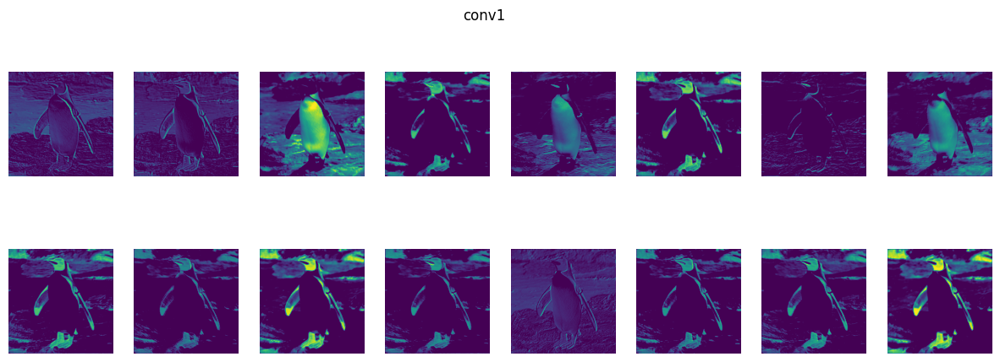

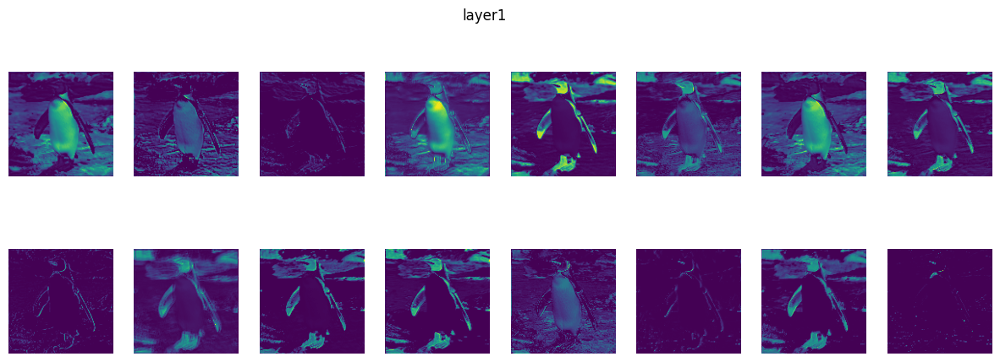

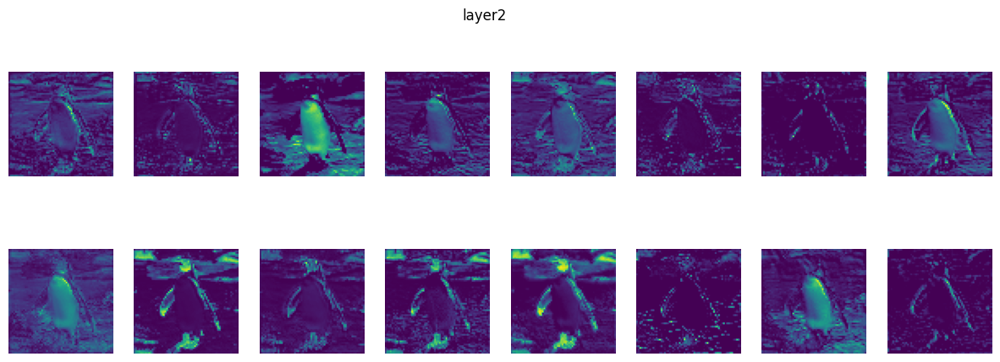

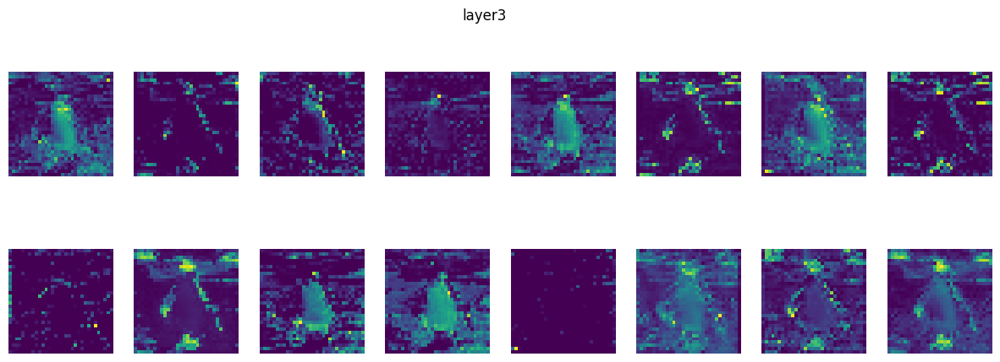

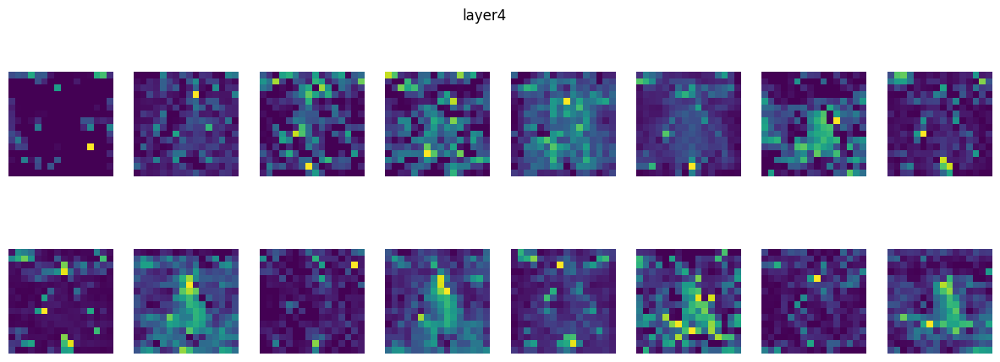

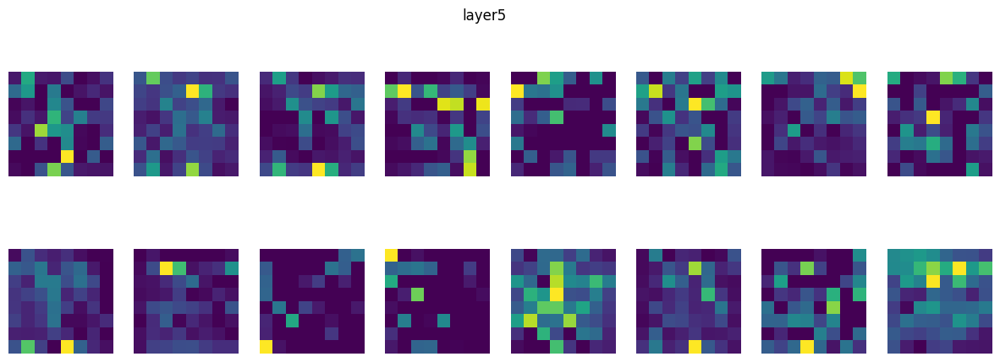

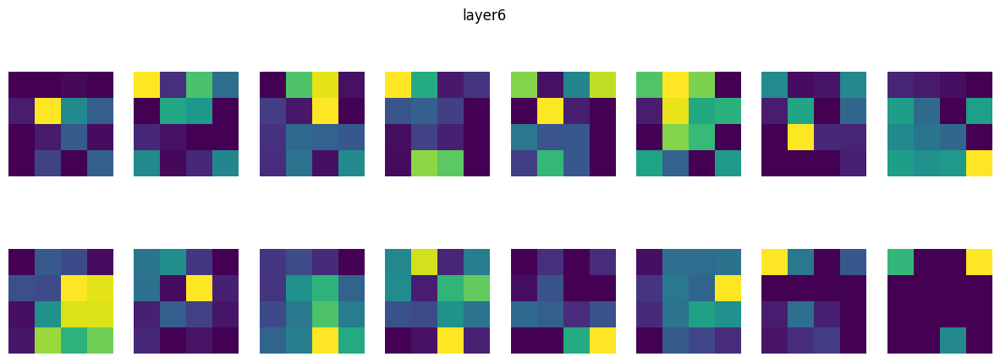

In [ ]:
# Visualize the figure here, so it is exported nicely
plot_model_features()